# `l2hmc`: Example

<a href="https://arxiv.org/abs/2105.03418"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2105.03418-B31B1B.svg" align="left"></a> <a href="https://arxiv.org/abs/2112.01582"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2112.01582-B31B1B.svg" align="left" style="margin-left:10px;"></a><br>


This notebook will (attempt) to walk through the steps needed to successfully instantiate and "run" an experiment.

For this example, we wish to train the L2HMC sampler for the 2D $U(1)$ lattice gauge model with Wilson action:

$$
S_{\beta}(n) = \beta \sum_{n}\sum_{\mu<\nu}\mathrm{Re}\left[1 - U_{\mu\nu}(n) \right]
$$

This consists of the following steps:
  1. Build an `Experiment` by parsing our configuration object
  2. Train our model using the `Experiment.train()` method
  3. Evaluate our trained model `Experiment.evaluate(job_type='eval')`
  4. Compare our trained models' performance against generic HMC `Experiment.evaluate(job_type='hmc')`
  

<div class="alert alert-block alert-info" style="background:rgba(174, 129, 255, 0.1);color:#AE81FF; border-radius:5px; border: none;">
<span style="font-weight:700; font-size:1.5em;">Evaluating Performance</span>
    
Explicitly, we measure the performance of our model by comparing the _tunneling rate_ $\delta Q$ of our **trained** sampler to that of generic HMC.
    
Explicitly, the tunneling rate is given by:
    
$$
\delta Q = \frac{1}{N_{\mathrm{chains}}}\sum_{\mathrm{chains}} \left|Q_{i+1} - Q_{i}\right|
$$
    
where the difference is between subsequent states in a chain, and the sum is over all $N$ chains (each being ran in parallel, _independently_).
    
Since our goal is to generate _independent configurations_, the more our sampler tunnels between different topological sectors (_tunneling rate_), the more efficient our sampler.
    
</div>


## Imports / Setup

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib widget

import os
import warnings

warnings.filterwarnings('ignore')
os.environ['TORCH_CPP_LOG_LEVEL'] = 'ERROR'
os.environ['AUTOGRAPH_VERBOSITY'] = '10'
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
!echo $CUDA_VISIBLE_DEVICES

0


In [2]:
from __future__ import absolute_import, print_function, annotations, division

import logging
from rich.style import Style
from rich.console import Console
from rich.logging import RichHandler
from l2hmc.utils.rich import get_console
from l2hmc.utils.plot_helpers import set_plot_style
from l2hmc.main import build_experiment

set_plot_style()

console = get_console()

log = logging.getLogger()

handler = RichHandler(
    rich_tracebacks=True,
    tracebacks_show_locals=True,
    console=console,
    show_path=False,
    log_time_format='[%H:%m:%S]',
    enable_link_path=False,
)

log.handlers = [handler]

log.setLevel('INFO')

tlog = logging.getLogger('torch')
tlog.setLevel('ERROR')

wblog = logging.getLogger('wandb')
wblog.setLevel('CRITICAL')

--------------------------------------------------------------------------

  Local host:   thetagpu23
  Local device: mlx5_0
--------------------------------------------------------------------------


# Initialize and Build `Experiment` objects:

- The `l2hmc.main` module provides a function `build_experiment`:

```python
def build_experiment(overrides: list[str]) -> tfExperiment | ptExperiment:
    ...
```

which will:

1. Load the default options from `conf/config.yaml`
2. Override the default options with any values provided in `overrides`
3. Parse these options and build an `ExperimentConfig` which uniquely defines an experiment
3. Instantiate / return an `Experiment` from the `ExperimentConfig`.
   Depending on `framework=pytorch|tensorflow`:
       a. `framework=pytorch` -> `l2hmc.experiment.pytorch.Experiment`
       b. `framework=tensorflow` -> `l2hmc.experiment.tensorflow.Experiment`

```python
>>> train_output = experiment.train()
>>> eval_output = experiment.evaluate(job_type='eval')
>>> hmc_output = experiment.evaluate(job_type='hmc')
```

<div class="alert alert-block alert-info" style="background:rgba(100, 100, 100, 0.2);color:rgb(150,150,150); border-radius:5px; border:none">
<b><u>Overriding Defaults</u></b>

Specifics about the training / evaluation / hmc runs can be flexibly overridden by passing arguments to the training / evaluation / hmc runs, respectively
</div>

In [3]:
defaults = [
    'conv=none',
    # ---------------------------------
    'steps.nera=5',
    'steps.nepoch=1000',
    'steps.print=200',
    'steps.log=50',
    'steps.test=1000',
    # ---------------------------------
    'annealing_schedule.beta_init=4.0',
    'annealing_schedule.beta_final=5.0',
    # ---------------------------------
    'init_aim=false',
    'init_wandb=false',
]

outputs = {
    'pytorch': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
    'tensorflow': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
}

## Pytorch

In [4]:
ptExpU1 = build_experiment(
    overrides=[
        *defaults,
        'framework=pytorch',
        'backend=DDP',
        'precision=fp16',
    ]
)

[06:02:44] INFO     Global Rank: 0 / 0

[06:02:04] INFO     Caught MASTER_PORT:2345 from environment!

           WARNING  Using torch.float16 on cuda!

[06:02:06] INFO     Looking for checkpoints in:                                              
                     /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd
                    /src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/sepnets-True/merge-Tr
                    ue/net-16-16-16_dp-0.2_bn-False/pytorch

           INFO     Loading model from: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU
                    /projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/se
                    pnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-4-0-2840
                    1-2023-02-09-005233.pth

           INFO     Loading checkpoint from: /lus/grand/projects/DLHMC/foremans/locations/the
                    taGPU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-Tr
                    ue/sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-4-0-
                    28401-2023-02-09-005233.tar

           WARNING  Restoring global step from ckpt! self._gstep: 28401

           WARNING  Using `torch.optim.Adam` optimizer

[06:02:07] INFO     Caught MASTER_PORT:2345 from environment!

## TensorFlow

In [5]:
tfExpU1 = build_experiment(
    overrides=[
        *defaults,
        'framework=tensorflow',
        'backend=horovod',
    ]
)

[06:02:10] INFO     1, Physical GPUs and 1 Logical GPUs

           WARNING  Using: float32 precision

           INFO     RANK: 0, LOCAL_RANK: 0

# Training

## PyTorch

### Training

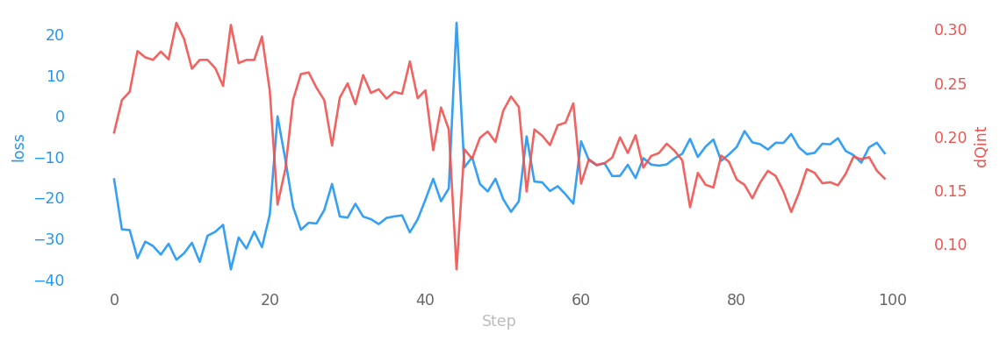

[06:02:13] INFO     [TRAINING] x.dtype: torch.float32

           INFO     [TRAINING] self._dtype: torch.float16

────────────────────────────────── ERA: 0 / 4, BETA: 4.000 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[06:02:21] INFO     era=0   epoch=0   tstep=28402 dt=0.2810 beta=4.0000 loss=-15.5066        
                    dQsin=0.1847 dQint=0.2038 energy=532.7898 logprob=437.4711 logdet=95.3187
                    sldf=326.2930 sldb=-326.2941 sld=95.3187 xeps=0.2043 veps=0.1701         
                    acc=0.1722 sumlogdet=0.0024 acc_mask=0.1826 plaqs=0.8633 intQ=-0.0185    
                    sinQ=-0.0146 lr=0.0010

[06:02:26] INFO     era=0   epoch=200 tstep=28602 dt=0.2402 beta=4.0000 loss=-30.7722        
                    dQsin=0.2511 dQint=0.2739 energy=532.5494 logprob=436.5396 logdet=96.0097
                    sldf=353.3446 sldb=-353.3208 sld=96.0097 xeps=0.1979 veps=0.1883         
                    acc=0.2844 sumlogdet=-0.0317 acc_mask=0.2871 plaqs=0.8638 intQ=-0.0376   
                    sinQ=-0.0400 lr=0.0010

[07:02:32] INFO     era=0   epoch=400 tstep=28802 dt=0.2405 beta=4.0000 loss=-35.2194        
                    dQsin=0.2913 dQint=0.3061 energy=536.0668 logprob=438.3641 logdet=97.7027
                    sldf=370.5129 sldb=-370.5000 sld=97.7027 xeps=0.1945 veps=0.1963         
                    acc=0.3429 sumlogdet=0.0018 acc_mask=0.3447 plaqs=0.8638 intQ=-0.0171    
                    sinQ=-0.0107 lr=0.0010

[07:02:38] INFO     era=0   epoch=600 tstep=29002 dt=0.2407 beta=4.0000 loss=-29.3475        
                    dQsin=0.2569 dQint=0.2715 energy=542.3632 logprob=441.1002               
                    logdet=101.2630 sldf=381.8224 sldb=-381.7900 sld=101.2630 xeps=0.1958    
                    veps=0.1983 acc=0.3009 sumlogdet=0.0168 acc_mask=0.3018 plaqs=0.8633     
                    intQ=-0.0190 sinQ=-0.0155 lr=0.0010

[07:02:44] INFO     era=0   epoch=800 tstep=29202 dt=0.4602 beta=4.0000 loss=-29.7624        
                    dQsin=0.2510 dQint=0.2686 energy=546.9284 logprob=444.0461               
                    logdet=102.8824 sldf=390.3112 sldb=-390.2651 sld=102.8824 xeps=0.1965    
                    veps=0.2001 acc=0.3106 sumlogdet=0.0221 acc_mask=0.3135 plaqs=0.8638     
                    intQ=-0.0121 sinQ=-0.0156 lr=0.0010

[07:02:46] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-0-0-294
                    01-2023-02-09-070346.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-0-0-294
                    01-2023-02-09-070346.pth

           INFO     Saving took: 0.151541s

           INFO     Era 0 took: 333.067s

────────────────────────────────── ERA: 1 / 4, BETA: 4.250 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:54] INFO     era=1   epoch=0   tstep=29402 dt=0.2403 beta=4.2500 loss=-24.1424        
                    dQsin=0.2383 dQint=0.2427 energy=548.2895 logprob=444.9192               
                    logdet=103.3703 sldf=397.7579 sldb=-397.7545 sld=103.3703 xeps=0.1948    
                    veps=0.2034 acc=0.3491 sumlogdet=-0.0228 acc_mask=0.3442 plaqs=0.8721    
                    intQ=0.0327 sinQ=0.0240 lr=0.0010

[07:02:00] INFO     era=1   epoch=200 tstep=29602 dt=0.2408 beta=4.2500 loss=-27.8579        
                    dQsin=0.2447 dQint=0.2583 energy=546.1447 logprob=443.9677               
                    logdet=102.1770 sldf=385.2690 sldb=-385.2795 sld=102.1770 xeps=0.2016    
                    veps=0.1941 acc=0.2884 sumlogdet=-0.0160 acc_mask=0.2861 plaqs=0.8726    
                    intQ=0.0073 sinQ=0.0095 lr=0.0010

[07:02:07] INFO     era=1   epoch=400 tstep=29802 dt=0.2416 beta=4.2500 loss=-16.6340        
                    dQsin=0.1811 dQint=0.1915 energy=544.2852 logprob=443.0406               
                    logdet=101.2446 sldf=381.7631 sldb=-381.7180 sld=101.2446 xeps=0.2007    
                    veps=0.1919 acc=0.2416 sumlogdet=0.0641 acc_mask=0.2393 plaqs=0.8726     
                    intQ=-0.0356 sinQ=-0.0252 lr=0.0010

[07:02:13] INFO     era=1   epoch=600 tstep=30002 dt=0.2435 beta=4.2500 loss=-24.6415        
                    dQsin=0.2493 dQint=0.2574 energy=546.4794 logprob=443.3304               
                    logdet=103.1490 sldf=391.4536 sldb=-391.4543 sld=103.1490 xeps=0.1985    
                    veps=0.1960 acc=0.3211 sumlogdet=-0.0167 acc_mask=0.3340 plaqs=0.8730    
                    intQ=0.0258 sinQ=0.0231 lr=0.0010

[07:02:19] INFO     era=1   epoch=800 tstep=30202 dt=0.2385 beta=4.2500 loss=-24.5960        
                    dQsin=0.2343 dQint=0.2417 energy=547.2016 logprob=443.5366               
                    logdet=103.6650 sldf=387.8152 sldb=-387.7542 sld=103.6650 xeps=0.2007    
                    veps=0.1940 acc=0.3007 sumlogdet=0.0071 acc_mask=0.2930 plaqs=0.8726     
                    intQ=0.0327 sinQ=0.0251 lr=0.0010

[07:02:23] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-1-0-304
                    01-2023-02-09-070923.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-1-0-304
                    01-2023-02-09-070923.pth

           INFO     Saving took: 0.151862s

           INFO     Era 1 took: 336.944s

           INFO     Avgs over last era:                                                      
                     tstep=29877.0000, dt=0.2408, beta=4.2500, loss=-22.6150, dQsin=0.2242,  
                    dQint=0.2327, energy=547.1271, logprob=444.2207, logdet=102.9065,        
                    sldf=388.7712, sldb=-388.7778, sld=102.9065, xeps=0.1997, veps=0.1954,   
                    acc=0.2885, sumlogdet=-0.0007, acc_mask=0.2872, plaqs=0.8726,            
                    intQ=0.0103, sinQ=0.0091, lr=0.0010                                      
           

────────────────────────────────── ERA: 2 / 4, BETA: 4.500 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:31] INFO     era=2   epoch=0   tstep=30402 dt=0.2446 beta=4.5000 loss=-20.4995        
                    dQsin=0.2418 dQint=0.2432 energy=548.0561 logprob=444.6543               
                    logdet=103.4017 sldf=391.8174 sldb=-391.8343 sld=103.4017 xeps=0.2000    
                    veps=0.1965 acc=0.3389 sumlogdet=-0.0106 acc_mask=0.3486 plaqs=0.8799    
                    intQ=-0.0122 sinQ=-0.0061 lr=0.0010

[07:02:42] INFO     era=2   epoch=200 tstep=30602 dt=0.2485 beta=4.5000 loss=22.8638         
                    dQsin=0.0710 dQint=0.0760 energy=547.6339 logprob=445.0759               
                    logdet=102.5580 sldf=381.2112 sldb=-381.1882 sld=102.5580 xeps=0.2053    
                    veps=0.1879 acc=0.0971 sumlogdet=0.0062 acc_mask=0.1016 plaqs=0.8804     
                    intQ=0.0429 sinQ=0.0363 lr=0.0010

[07:02:49] INFO     era=2   epoch=400 tstep=30802 dt=0.2449 beta=4.5000 loss=-18.4776        
                    dQsin=0.2045 dQint=0.2047 energy=545.8979 logprob=443.2375               
                    logdet=102.6605 sldf=372.4284 sldb=-372.4449 sld=102.6605 xeps=0.2029    
                    veps=0.1849 acc=0.2715 sumlogdet=0.0170 acc_mask=0.2690 plaqs=0.8804     
                    intQ=-0.0123 sinQ=-0.0096 lr=0.0010

[07:02:59] INFO     era=2   epoch=600 tstep=31002 dt=0.2507 beta=4.5000 loss=-20.8945        
                    dQsin=0.2274 dQint=0.2275 energy=546.3629 logprob=443.8959               
                    logdet=102.4671 sldf=376.6329 sldb=-376.6114 sld=102.4671 xeps=0.2006    
                    veps=0.1891 acc=0.3299 sumlogdet=-0.0179 acc_mask=0.3340 plaqs=0.8799    
                    intQ=0.0092 sinQ=0.0086 lr=0.0010

[07:02:07] INFO     era=2   epoch=800 tstep=31202 dt=0.2475 beta=4.5000 loss=-18.3674        
                    dQsin=0.1954 dQint=0.1920 energy=543.6738 logprob=442.4407               
                    logdet=101.2331 sldf=374.4111 sldb=-374.4282 sld=101.2331 xeps=0.2021    
                    veps=0.1864 acc=0.2981 sumlogdet=0.0206 acc_mask=0.2900 plaqs=0.8804     
                    intQ=0.0728 sinQ=0.0622 lr=0.0010

[07:02:11] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-2-0-314
                    01-2023-02-09-071511.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-2-0-314
                    01-2023-02-09-071511.pth

           INFO     Saving took: 0.153811s

           INFO     Era 2 took: 348.259s

           INFO     Avgs over last era:                                                      
                     tstep=30877.0000, dt=0.2510, beta=4.5000, loss=-15.1508, dQsin=0.1970,  
                    dQint=0.1999, energy=546.1856, logprob=443.4483, logdet=102.7373,        
                    sldf=377.8717, sldb=-377.8592, sld=102.7373, xeps=0.2021, veps=0.1883,   
                    acc=0.2777, sumlogdet=0.0079, acc_mask=0.2791, plaqs=0.8804, intQ=0.0097,
                    sinQ=0.0090, lr=0.0010                                                   
           

────────────────────────────────── ERA: 3 / 4, BETA: 4.750 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:19] INFO     era=3   epoch=0   tstep=31402 dt=0.2478 beta=4.7500 loss=-6.1737         
                    dQsin=0.1626 dQint=0.1560 energy=542.1373 logprob=440.9275               
                    logdet=101.2099 sldf=376.2009 sldb=-376.2468 sld=101.2099 xeps=0.2002    
                    veps=0.1882 acc=0.2989 sumlogdet=0.0000 acc_mask=0.2969 plaqs=0.8877     
                    intQ=0.0113 sinQ=0.0080 lr=0.0010

[07:02:28] INFO     era=3   epoch=200 tstep=31602 dt=0.2486 beta=4.7500 loss=-14.7111        
                    dQsin=0.1885 dQint=0.1804 energy=543.0103 logprob=441.3217               
                    logdet=101.6887 sldf=373.9318 sldb=-373.9531 sld=101.6887 xeps=0.1992    
                    veps=0.1878 acc=0.3333 sumlogdet=0.0068 acc_mask=0.3237 plaqs=0.8877     
                    intQ=0.0068 sinQ=0.0004 lr=0.0010

[07:02:36] INFO     era=3   epoch=400 tstep=31802 dt=0.2488 beta=4.7500 loss=-10.3183        
                    dQsin=0.1768 dQint=0.1710 energy=542.5210 logprob=440.8352               
                    logdet=101.6858 sldf=372.0787 sldb=-372.0690 sld=101.6858 xeps=0.2007    
                    veps=0.1843 acc=0.3210 sumlogdet=0.0122 acc_mask=0.3169 plaqs=0.8877     
                    intQ=-0.0010 sinQ=-0.0010 lr=0.0010

[07:02:45] INFO     era=3   epoch=600 tstep=32002 dt=0.2493 beta=4.7500 loss=-10.3807        
                    dQsin=0.1921 dQint=0.1867 energy=543.0565 logprob=441.1399               
                    logdet=101.9165 sldf=379.0989 sldb=-379.0955 sld=101.9165 xeps=0.1989    
                    veps=0.1895 acc=0.3276 sumlogdet=-0.0033 acc_mask=0.3296 plaqs=0.8877    
                    intQ=0.0146 sinQ=0.0176 lr=0.0010

[07:02:53] INFO     era=3   epoch=800 tstep=32202 dt=0.2491 beta=4.7500 loss=-7.4913         
                    dQsin=0.1656 dQint=0.1550 energy=544.7919 logprob=441.5078               
                    logdet=103.2840 sldf=376.9262 sldb=-376.9218 sld=103.2840 xeps=0.1967    
                    veps=0.1895 acc=0.3059 sumlogdet=0.0439 acc_mask=0.3022 plaqs=0.8867     
                    intQ=-0.0019 sinQ=-0.0016 lr=0.0010

[07:02:57] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-3-0-324
                    01-2023-02-09-072057.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-3-0-324
                    01-2023-02-09-072057.pth

           INFO     Saving took: 0.151377s

           INFO     Era 3 took: 345.782s

           INFO     Avgs over last era:                                                      
                     tstep=31877.0000, dt=0.2598, beta=4.7500, loss=-10.6060, dQsin=0.1832,  
                    dQint=0.1755, energy=544.1747, logprob=441.9111, logdet=102.2635,        
                    sldf=376.8787, sldb=-376.8926, sld=102.2635, xeps=0.1986, veps=0.1888,   
                    acc=0.3230, sumlogdet=0.0017, acc_mask=0.3199, plaqs=0.8872,             
                    intQ=-0.0027, sinQ=-0.0023, lr=0.0010                                    
           

────────────────────────────────── ERA: 4 / 4, BETA: 5.000 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:05] INFO     era=4   epoch=0   tstep=32402 dt=0.2431 beta=5.0000 loss=-7.5706         
                    dQsin=0.1712 dQint=0.1598 energy=545.9280 logprob=441.7004               
                    logdet=104.2276 sldf=384.4342 sldb=-384.4102 sld=104.2276 xeps=0.1955    
                    veps=0.1915 acc=0.3766 sumlogdet=0.0131 acc_mask=0.3628 plaqs=0.8936     
                    intQ=-0.0321 sinQ=-0.0263 lr=0.0010

[07:02:12] INFO     era=4   epoch=200 tstep=32602 dt=0.2377 beta=5.0000 loss=-8.2148         
                    dQsin=0.1808 dQint=0.1680 energy=542.4662 logprob=439.8712               
                    logdet=102.5950 sldf=368.9111 sldb=-368.9348 sld=102.5950 xeps=0.1972    
                    veps=0.1850 acc=0.3714 sumlogdet=0.0007 acc_mask=0.3652 plaqs=0.8936     
                    intQ=-0.0137 sinQ=-0.0150 lr=0.0010

[07:02:20] INFO     era=4   epoch=400 tstep=32802 dt=0.2439 beta=5.0000 loss=-7.6935         
                    dQsin=0.1674 dQint=0.1476 energy=541.6926 logprob=439.1145               
                    logdet=102.5780 sldf=369.5588 sldb=-369.5577 sld=102.5780 xeps=0.1967    
                    veps=0.1860 acc=0.3597 sumlogdet=0.0183 acc_mask=0.3574 plaqs=0.8936     
                    intQ=-0.0347 sinQ=-0.0293 lr=0.0010

[07:02:28] INFO     era=4   epoch=600 tstep=33002 dt=0.2485 beta=5.0000 loss=-6.9267         
                    dQsin=0.1660 dQint=0.1574 energy=540.0461 logprob=439.3063               
                    logdet=100.7398 sldf=357.8176 sldb=-357.8314 sld=100.7398 xeps=0.1989    
                    veps=0.1779 acc=0.3428 sumlogdet=0.0037 acc_mask=0.3340 plaqs=0.8936     
                    intQ=0.0150 sinQ=0.0154 lr=0.0010

[07:02:36] INFO     era=4   epoch=800 tstep=33202 dt=0.2441 beta=5.0000 loss=-11.4188        
                    dQsin=0.1913 dQint=0.1788 energy=538.0068 logprob=437.7985               
                    logdet=100.2084 sldf=358.7085 sldb=-358.7388 sld=100.2084 xeps=0.1979    
                    veps=0.1789 acc=0.3699 sumlogdet=-0.0082 acc_mask=0.3652 plaqs=0.8936    
                    intQ=-0.0072 sinQ=-0.0004 lr=0.0010

[07:02:40] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-4-0-334
                    01-2023-02-09-072640.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-4-0-334
                    01-2023-02-09-072640.pth

           INFO     Saving took: 0.150353s

           INFO     Era 4 took: 343.273s

[07:02:20] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/t
                    rain/plots/ridgeplots/svgs/energy_ridgeplot.svg

[07:02:21] INFO     Ridgeplot for energy took 30.739s

[07:02:51] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/t
                    rain/plots/ridgeplots/svgs/logprob_ridgeplot.svg

           INFO     Ridgeplot for logprob took 30.371s

[07:02:19] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/t
                    rain/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[07:02:20] INFO     Ridgeplot for logdet took 28.924s

[07:02:47] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/t
                    rain/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[07:02:48] INFO     Ridgeplot for sldf took 27.542s

[07:02:14] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/t
                    rain/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[07:02:15] INFO     Ridgeplot for sldb took 27.151s

[07:02:44] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/t
                    rain/plots/ridgeplots/svgs/sld_ridgeplot.svg

           INFO     Ridgeplot for sld took 29.410s

[07:02:00] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/
                    train/data/train_data.h5

[07:02:01] INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

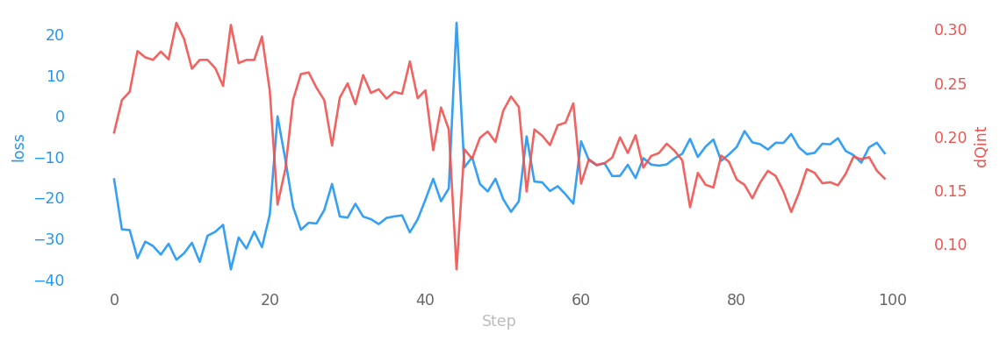

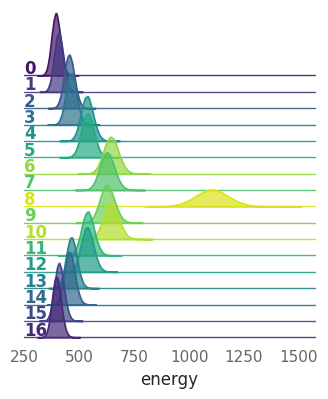

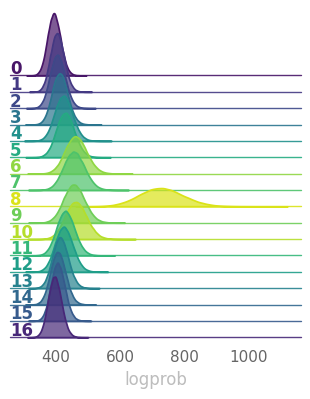

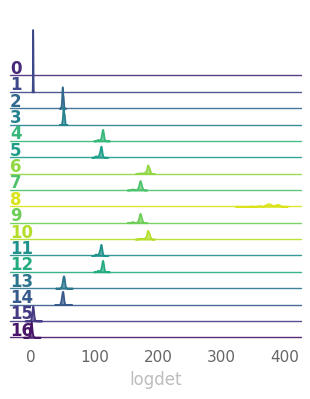

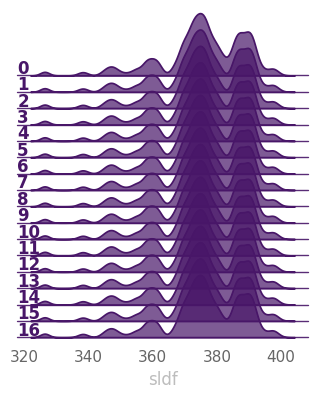

...

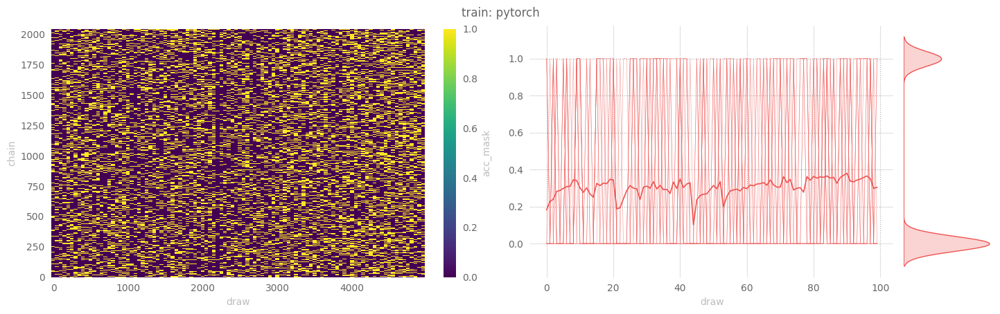

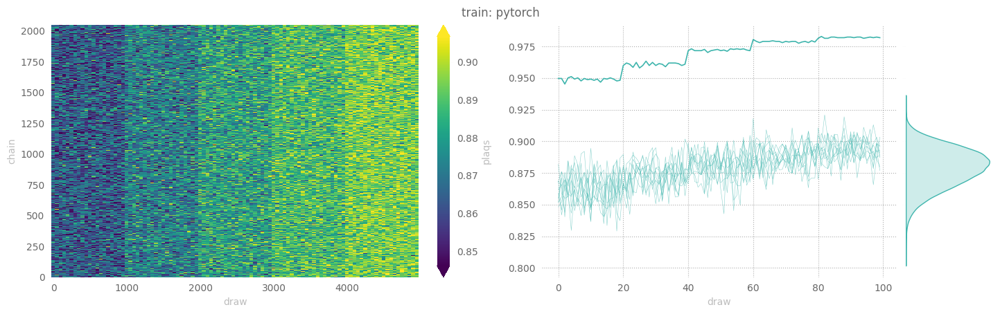

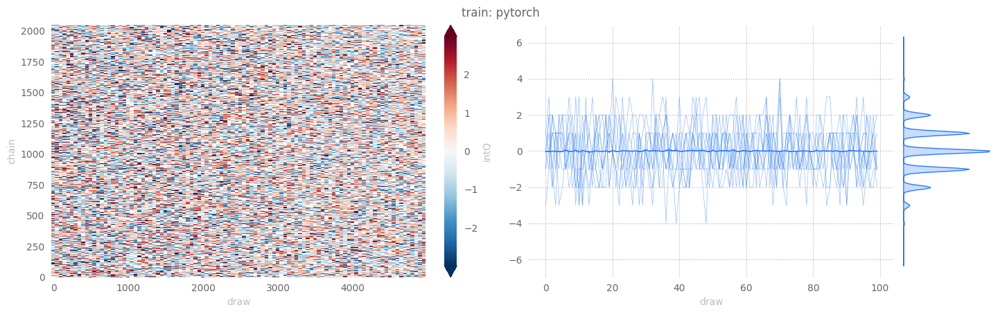

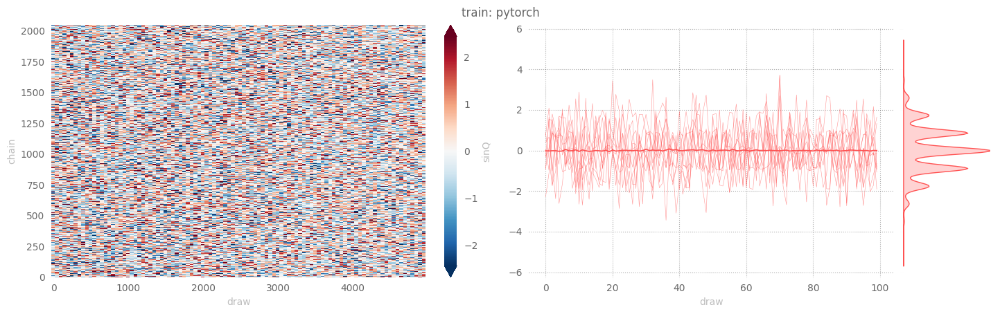

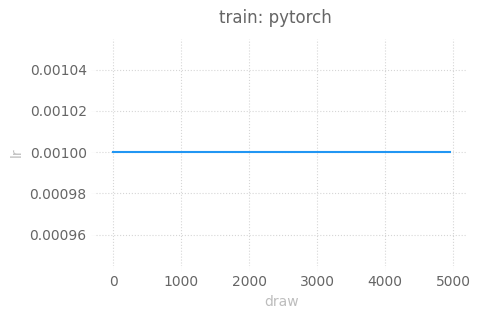

In [6]:
import seaborn as sns
from l2hmc.utils.plot_helpers import set_plot_style

set_plot_style()
outputs['pytorch']['train'] = ptExpU1.train()

### Inference

#### Evaluation

[07:02:08] WARNING  x.shape (original): torch.Size([2048, 2, 16, 16])

           WARNING  x[:nchains].shape: torch.Size([128, 2, 16, 16])

[07:02:09] INFO     eps=None                                                                 
                    beta=5.0                                                                 
                    nlog=10                                                                  
                    table=<rich.table.Table object at 0x7ff14c0b1220>                        
                    nprint=250                                                               
                    eval_steps=2000                                                          
                    nleapfrog=None

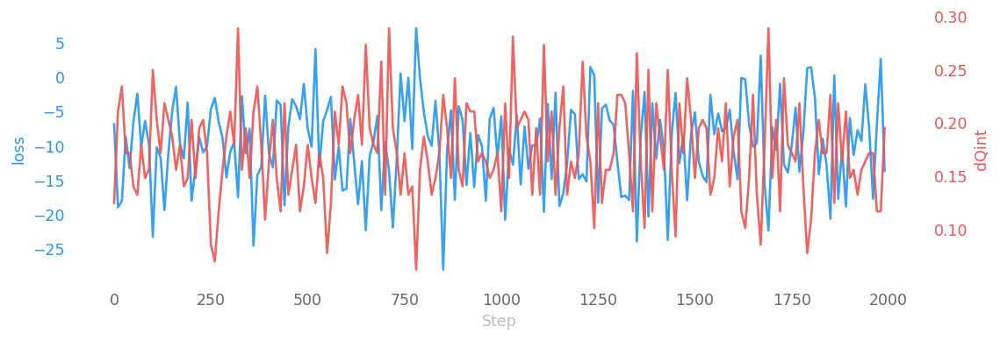

eval:   0%|          | 0/2000 [00:00<?, ?it/s]

[07:02:12] INFO     estep=0   dt=0.1295 beta=5.0000 loss=-6.8211 dQsin=0.1225 dQint=0.1250   
                    energy=537.1237 logprob=437.5452 logdet=99.5786 sldf=347.8405            
                    sldb=-347.5073 sld=99.5786 xeps=0.2020 veps=0.1744 acc=0.3107            
                    sumlogdet=0.0678 acc_mask=0.2734 plaqs=0.8932 intQ=0.0547 sinQ=0.0588

[07:02:41] INFO     estep=250 dt=0.0866 beta=5.0000 loss=-4.5967 dQsin=0.1174 dQint=0.0859   
                    energy=536.5941 logprob=437.2413 logdet=99.3528 sldf=347.5731            
                    sldb=-347.5799 sld=99.3528 xeps=0.2020 veps=0.1744 acc=0.3313            
                    sumlogdet=-0.0324 acc_mask=0.3125 plaqs=0.8942 intQ=-0.0781 sinQ=-0.0733

[07:02:09] INFO     estep=500 dt=0.0885 beta=5.0000 loss=-7.4248 dQsin=0.1835 dQint=0.1797   
                    energy=540.4035 logprob=441.0239 logdet=99.3796 sldf=347.6350            
                    sldb=-347.5941 sld=99.3796 xeps=0.2020 veps=0.1744 acc=0.3325            
                    sumlogdet=0.0388 acc_mask=0.3281 plaqs=0.8941 intQ=-0.1719 sinQ=-0.1414

[07:02:38] INFO     estep=750 dt=0.0879 beta=5.0000 loss=-6.3604 dQsin=0.1664 dQint=0.1719   
                    energy=535.6497 logprob=436.3311 logdet=99.3187 sldf=347.5481            
                    sldb=-347.6262 sld=99.3187 xeps=0.2020 veps=0.1744 acc=0.3160            
                    sumlogdet=-0.0754 acc_mask=0.3125 plaqs=0.8937 intQ=0.0313 sinQ=0.0158

[07:02:07] INFO     estep=1000 dt=0.0910 beta=5.0000 loss=-5.6602 dQsin=0.1322 dQint=0.1172  
                    energy=539.2120 logprob=439.7777 logdet=99.4343 sldf=347.6761            
                    sldb=-347.4991 sld=99.4343 xeps=0.2020 veps=0.1744 acc=0.2698            
                    sumlogdet=0.0067 acc_mask=0.2422 plaqs=0.8924 intQ=0.0234 sinQ=0.0217

[07:02:37] INFO     estep=1250 dt=0.0890 beta=5.0000 loss=-18.2166 dQsin=0.2276 dQint=0.2188 
                    energy=541.1157 logprob=441.7270 logdet=99.3887 sldf=347.6188            
                    sldb=-347.5225 sld=99.3887 xeps=0.2020 veps=0.1744 acc=0.3139            
                    sumlogdet=0.0565 acc_mask=0.3125 plaqs=0.8929 intQ=-0.0547 sinQ=-0.0369

[07:02:07] INFO     estep=1500 dt=0.0898 beta=5.0000 loss=-5.0859 dQsin=0.1613 dQint=0.1484  
                    energy=539.9688 logprob=440.5143 logdet=99.4545 sldf=347.6813            
                    sldb=-347.3915 sld=99.4545 xeps=0.2020 veps=0.1744 acc=0.3150            
                    sumlogdet=0.2221 acc_mask=0.3047 plaqs=0.8932 intQ=-0.1484 sinQ=-0.1460

[07:02:36] INFO     estep=1750 dt=0.0895 beta=5.0000 loss=-9.9176 dQsin=0.1964 dQint=0.1719  
                    energy=539.2217 logprob=439.8452 logdet=99.3766 sldf=347.6303            
                    sldb=-347.6621 sld=99.3766 xeps=0.2020 veps=0.1744 acc=0.3258            
                    sumlogdet=0.0176 acc_mask=0.3281 plaqs=0.8934 intQ=0.0781 sinQ=0.0615

[07:02:10] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/e
                    val/plots/ridgeplots/svgs/energy_ridgeplot.svg

[07:02:11] INFO     Ridgeplot for energy took 4.589s

[07:02:15] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/e
                    val/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[07:02:16] INFO     Ridgeplot for logprob took 4.543s

[07:02:19] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/e
                    val/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[07:02:20] INFO     Ridgeplot for logdet took 4.647s

[07:02:24] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/e
                    val/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[07:02:25] INFO     Ridgeplot for sldf took 4.817s

[07:02:29] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/e
                    val/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[07:02:30] INFO     Ridgeplot for sldb took 5.005s

[07:02:34] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/e
                    val/plots/ridgeplots/svgs/sld_ridgeplot.svg

[07:02:35] INFO     Ridgeplot for sld took 4.827s

[07:02:46] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/
                    eval/data/eval_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

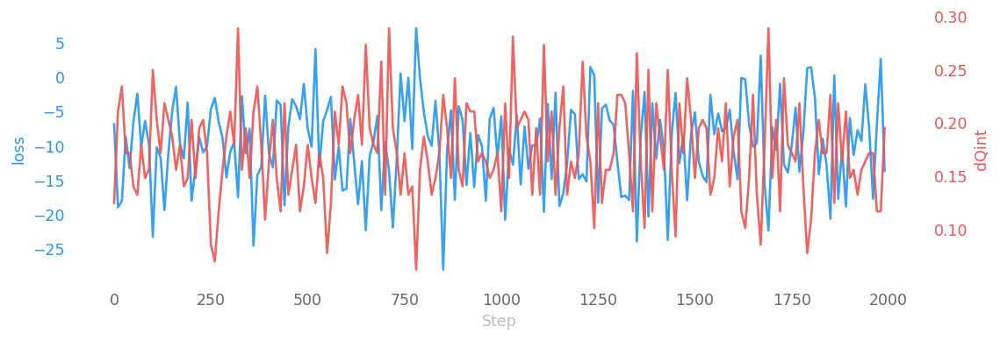

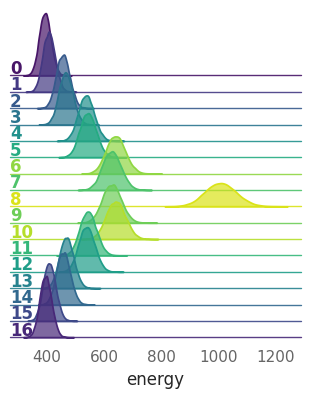

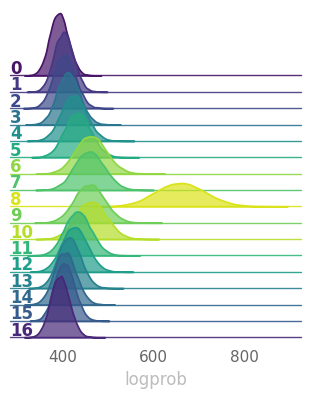

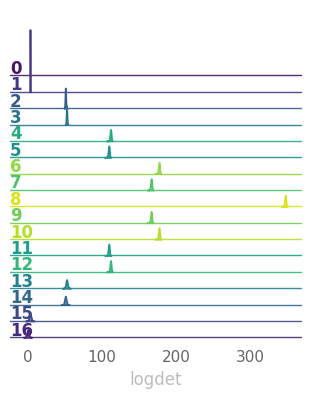

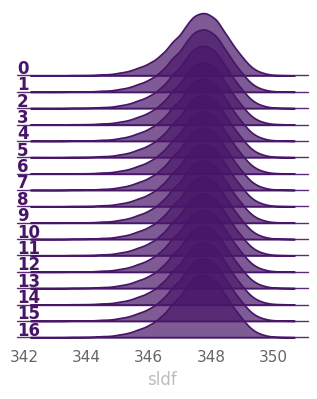

...

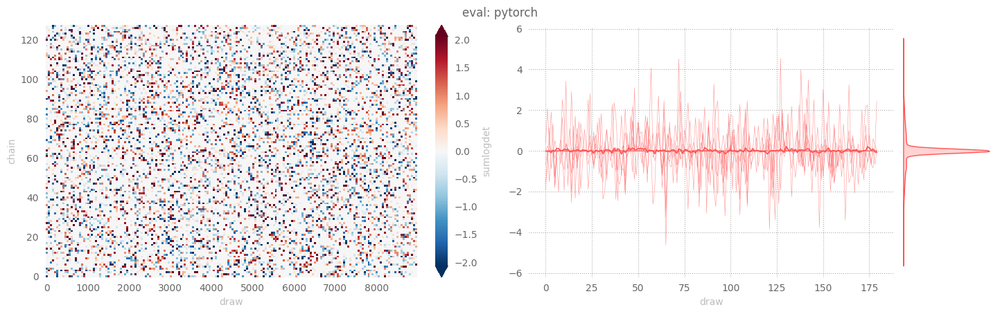

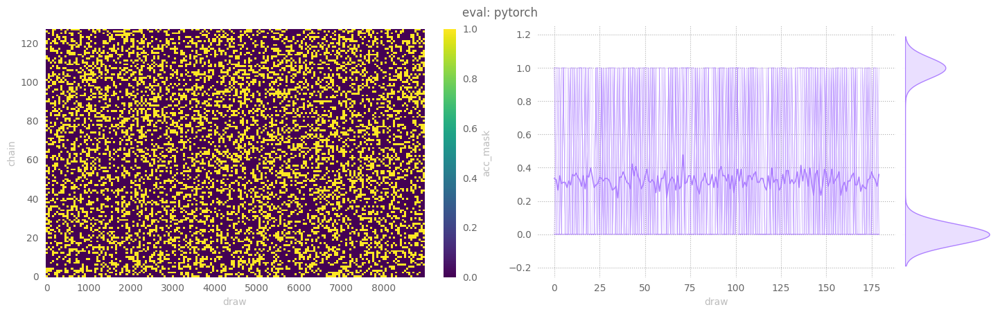

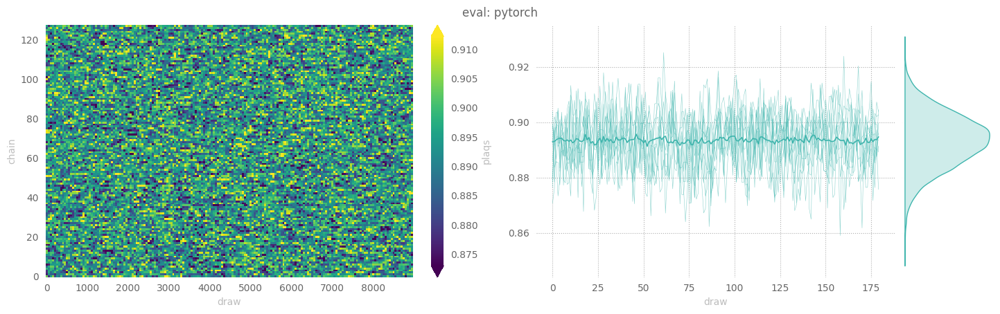

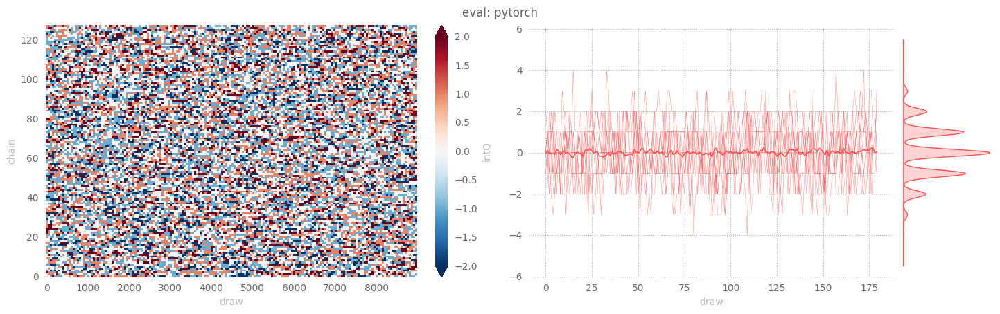

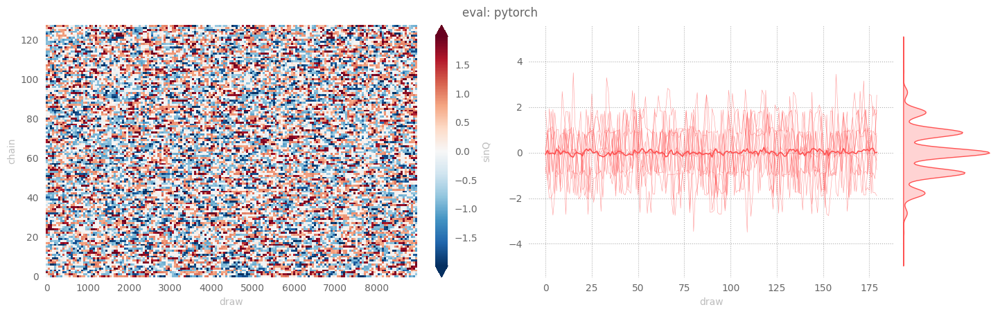

In [7]:
outputs['pytorch']['eval'] = ptExpU1.evaluate(
    job_type='eval',
    nprint=250,
    nchains=128,
    eval_steps=2000,
)

#### HMC

[07:02:54] WARNING  Step size `eps` not specified for HMC! Using default: 0.1250 for generic 
                    HMC

           WARNING  x.shape (original): torch.Size([2048, 2, 16, 16])

           WARNING  x[:nchains].shape: torch.Size([128, 2, 16, 16])

           INFO     eps=0.125                                                                
                    beta=5.0                                                                 
                    nlog=10                                                                  
                    table=<rich.table.Table object at 0x7ff248072130>                        
                    nprint=250                                                               
                    eval_steps=2000                                                          
                    nleapfrog=16

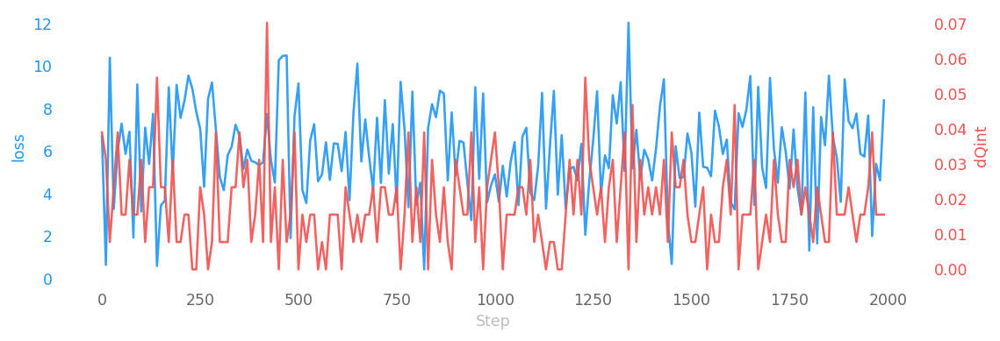

hmc:   0%|          | 0/2000 [00:00<?, ?it/s]

[07:02:57] INFO     hstep=0   dt=0.0266 beta=5.0000 loss=6.6829 dQsin=0.1134 dQint=0.0391    
                    energy=392.1799 logprob=392.1799 logdet=0.0000 acc=0.5927                
                    sumlogdet=0.0000 acc_mask=0.6484 plaqs=0.8934 intQ=0.1328 sinQ=0.1369

[07:02:10] INFO     hstep=250 dt=0.0268 beta=5.0000 loss=7.0396 dQsin=0.0940 dQint=0.0234    
                    energy=392.3897 logprob=392.3897 logdet=0.0000 acc=0.6441                
                    sumlogdet=0.0000 acc_mask=0.6406 plaqs=0.8933 intQ=-0.1172 sinQ=-0.1161

[07:02:23] INFO     hstep=500 dt=0.0267 beta=5.0000 loss=9.1865 dQsin=0.0972 dQint=0.0000    
                    energy=387.9113 logprob=387.9113 logdet=0.0000 acc=0.6101                
                    sumlogdet=0.0000 acc_mask=0.6094 plaqs=0.8955 intQ=0.1484 sinQ=0.1317

[07:02:36] INFO     hstep=750 dt=0.0268 beta=5.0000 loss=3.5871 dQsin=0.1182 dQint=0.0234    
                    energy=393.5311 logprob=393.5311 logdet=0.0000 acc=0.6547                
                    sumlogdet=0.0000 acc_mask=0.5938 plaqs=0.8918 intQ=0.1172 sinQ=0.1119

[07:02:50] INFO     hstep=1000 dt=0.0266 beta=5.0000 loss=4.9010 dQsin=0.1214 dQint=0.0391   
                    energy=394.3611 logprob=394.3611 logdet=0.0000 acc=0.6239                
                    sumlogdet=0.0000 acc_mask=0.6406 plaqs=0.8933 intQ=0.0469 sinQ=0.0409

[07:02:03] INFO     hstep=1250 dt=0.0265 beta=5.0000 loss=6.4865 dQsin=0.1212 dQint=0.0234   
                    energy=391.0599 logprob=391.0599 logdet=0.0000 acc=0.6089                
                    sumlogdet=0.0000 acc_mask=0.6016 plaqs=0.8943 intQ=-0.1562 sinQ=-0.1463

[07:02:17] INFO     hstep=1500 dt=0.0266 beta=5.0000 loss=5.9228 dQsin=0.1028 dQint=0.0078   
                    energy=393.0605 logprob=393.0605 logdet=0.0000 acc=0.6748                
                    sumlogdet=0.0000 acc_mask=0.6953 plaqs=0.8921 intQ=0.0391 sinQ=0.0489

[07:02:30] INFO     hstep=1750 dt=0.0265 beta=5.0000 loss=4.2195 dQsin=0.1210 dQint=0.0313   
                    energy=393.4561 logprob=393.4561 logdet=0.0000 acc=0.6633                
                    sumlogdet=0.0000 acc_mask=0.6797 plaqs=0.8925 intQ=0.0156 sinQ=0.0249

[07:02:49] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/h
                    mc/plots/ridgeplots/svgs/energy_ridgeplot.svg

           INFO     Ridgeplot for energy took 5.477s

[07:02:53] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/h
                    mc/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[07:02:54] INFO     Ridgeplot for logprob took 4.687s

[07:02:57] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/h
                    mc/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[07:02:58] INFO     Ridgeplot for logdet took 3.461s

[07:02:07] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065803/pytorch/
                    hmc/data/hmc_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

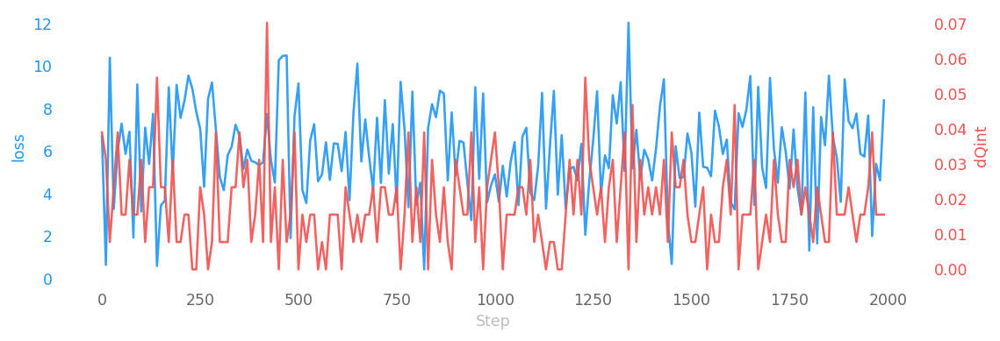

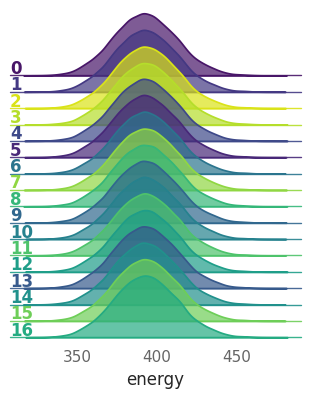

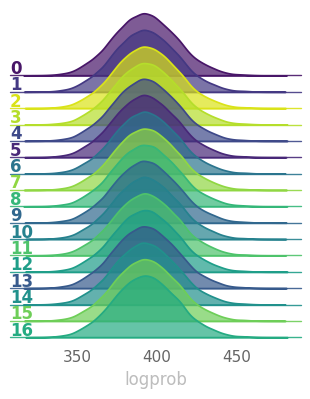

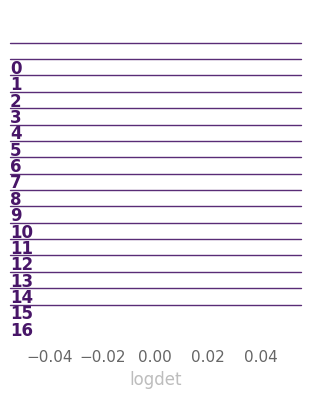

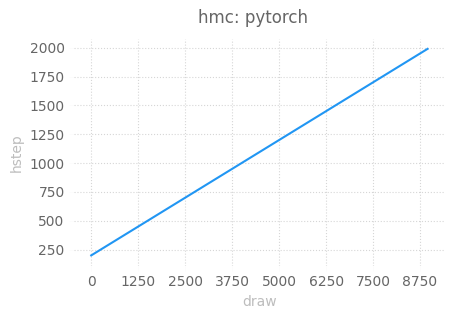

...

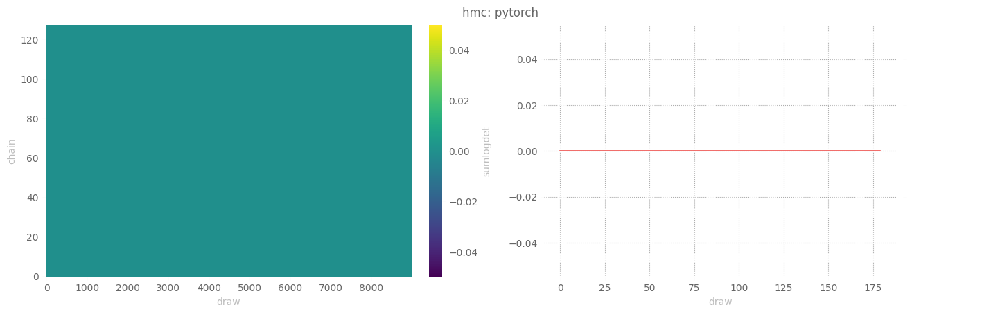

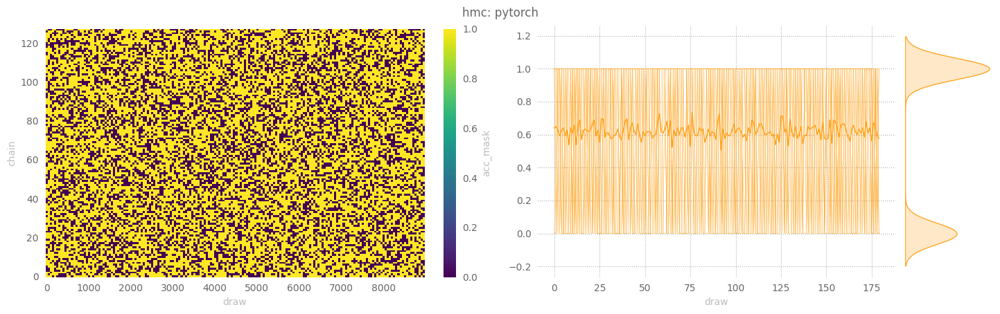

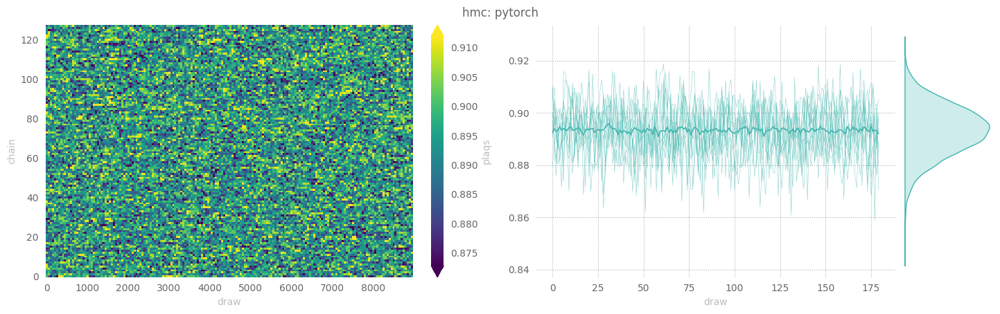

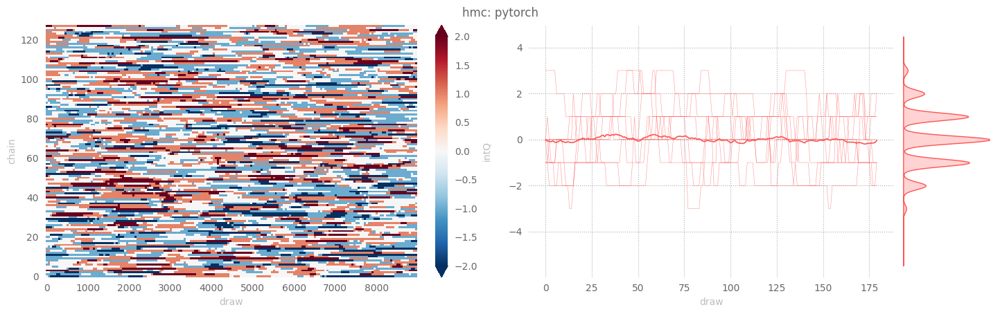

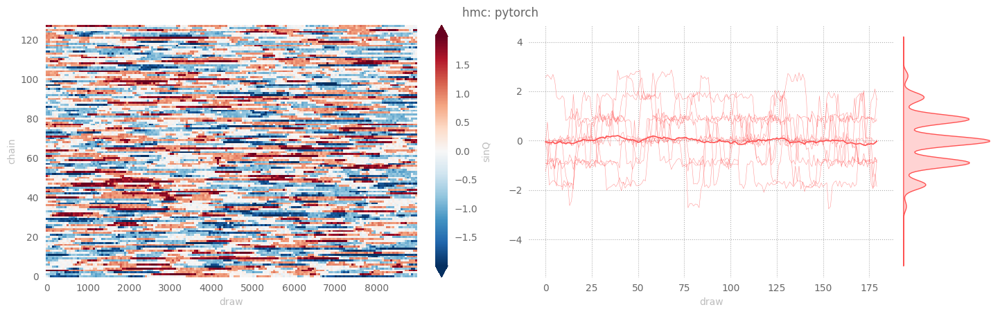

In [8]:
outputs['pytorch']['hmc'] = ptExpU1.evaluate(
    job_type='hmc',
    nprint=250,
    nchains=128,
    eval_steps=2000,
)

## TensorFlow

### Train

[07:02:16] INFO     Looking for checkpoints in: /lus/grand/projects/DLHMC/foremans/locations/
                    thetaGPU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit
                    -True/sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           WARNING  Restored checkpoint from: /lus/grand/projects/DLHMC/foremans/locations/th
                    etaGPU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-T
                    rue/sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow/ckpt-
                    54

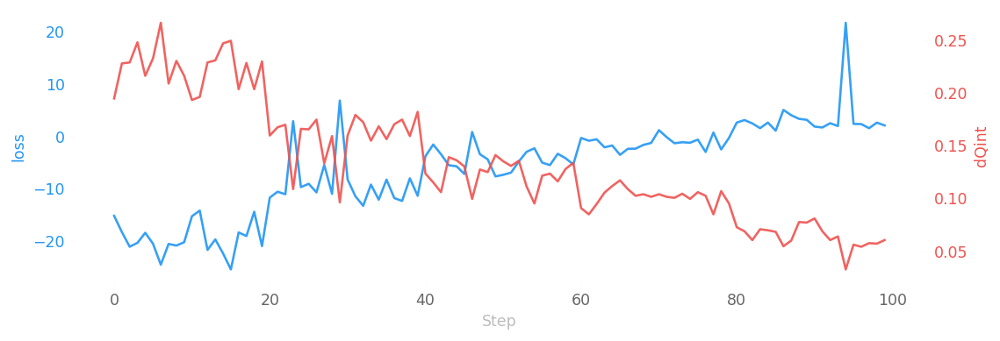

────────────────────────────────── ERA: 0 / 5, BETA: 4.000 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:48] INFO     era=0   epoch=0   tstep=38501.0000 dt=55.0694 beta=4.0000 loss=-15.1350  
                    dQsin=0.2270 dQint=0.1948 energy=405.5406 logprob=400.8284 logdet=4.7122 
                    sldf=7.1046 sldb=-2.3924 sld=4.7122 xeps=0.1823 veps=0.1452 acc=0.4168   
                    sumlogdet=0.0012 acc_mask=0.4233 plaqs=0.8635 intQ=-0.0244 sinQ=-0.0186  
                    lr=0.0010

[07:02:18] INFO     era=0   epoch=200 tstep=38701.0000 dt=0.1345 beta=4.0000 loss=-18.3701   
                    dQsin=0.2397 dQint=0.2163 energy=406.2819 logprob=401.4379 logdet=4.8439 
                    sldf=7.4229 sldb=-2.5789 sld=4.8439 xeps=0.1892 veps=0.1511 acc=0.4590   
                    sumlogdet=0.0067 acc_mask=0.4526 plaqs=0.8638 intQ=0.0415 sinQ=0.0344    
                    lr=0.0010

[07:02:47] INFO     era=0   epoch=400 tstep=38901.0000 dt=0.1279 beta=4.0000 loss=-20.8051   
                    dQsin=0.2368 dQint=0.2305 energy=409.5667 logprob=404.7272 logdet=4.8395 
                    sldf=7.4998 sldb=-2.6603 sld=4.8395 xeps=0.1997 veps=0.1470 acc=0.3710   
                    sumlogdet=-0.0019 acc_mask=0.3735 plaqs=0.8631 intQ=0.0010 sinQ=0.0023   
                    lr=0.0010

[07:02:17] INFO     era=0   epoch=600 tstep=39101.0000 dt=0.1246 beta=4.0000 loss=-21.6353   
                    dQsin=0.2374 dQint=0.2290 energy=409.0992 logprob=404.3895 logdet=4.7097 
                    sldf=7.3754 sldb=-2.6657 sld=4.7097 xeps=0.2028 veps=0.1484 acc=0.3704   
                    sumlogdet=-0.0016 acc_mask=0.3745 plaqs=0.8635 intQ=0.0098 sinQ=0.0116   
                    lr=0.0010

[07:02:46] INFO     era=0   epoch=800 tstep=39301.0000 dt=0.1263 beta=4.0000 loss=-18.3045   
                    dQsin=0.2145 dQint=0.2036 energy=407.8779 logprob=402.9665 logdet=4.9115 
                    sldf=7.6504 sldb=-2.7389 sld=4.9115 xeps=0.2033 veps=0.1533 acc=0.3556   
                    sumlogdet=-0.0020 acc_mask=0.3486 plaqs=0.8640 intQ=0.0044 sinQ=-0.0007  
                    lr=0.0010

[07:02:15] INFO     Saving took: 0.464053s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 0 took: 239.012s

────────────────────────────────── ERA: 1 / 5, BETA: 4.250 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:50] INFO     era=1   epoch=0   tstep=39501.0000 dt=0.1322 beta=4.2500 loss=-11.6655   
                    dQsin=0.1777 dQint=0.1597 energy=408.1368 logprob=403.5583 logdet=4.5786 
                    sldf=7.2251 sldb=-2.6464 sld=4.5786 xeps=0.2066 veps=0.1532 acc=0.3554   
                    sumlogdet=0.0039 acc_mask=0.3452 plaqs=0.8726 intQ=0.0669 sinQ=0.0571    
                    lr=0.0010

[07:02:19] INFO     era=1   epoch=200 tstep=39701.0000 dt=0.1243 beta=4.2500 loss=-9.6633    
                    dQsin=0.1824 dQint=0.1660 energy=408.8904 logprob=404.8332 logdet=4.0573 
                    sldf=6.5393 sldb=-2.4820 sld=4.0573 xeps=0.2057 veps=0.1516 acc=0.3400   
                    sumlogdet=0.0008 acc_mask=0.3389 plaqs=0.8727 intQ=-0.0063 sinQ=-0.0068  
                    lr=0.0010

[07:02:48] INFO     era=1   epoch=400 tstep=39901.0000 dt=0.1244 beta=4.2500 loss=-10.9448   
                    dQsin=0.1957 dQint=0.1592 energy=406.9243 logprob=402.4854 logdet=4.4389 
                    sldf=7.0833 sldb=-2.6444 sld=4.4389 xeps=0.2013 veps=0.1564 acc=0.4106   
                    sumlogdet=-0.0019 acc_mask=0.4175 plaqs=0.8723 intQ=-0.0269 sinQ=-0.0186 
                    lr=0.0010

[07:02:16] INFO     era=1   epoch=600 tstep=40101.0000 dt=0.1240 beta=4.2500 loss=-13.2261   
                    dQsin=0.1952 dQint=0.1724 energy=408.1900 logprob=403.5816 logdet=4.6083 
                    sldf=7.2372 sldb=-2.6288 sld=4.6083 xeps=0.2026 veps=0.1532 acc=0.3833   
                    sumlogdet=0.0073 acc_mask=0.3862 plaqs=0.8726 intQ=-0.0215 sinQ=-0.0195  
                    lr=0.0010

[07:02:46] INFO     era=1   epoch=800 tstep=40301.0000 dt=0.1259 beta=4.2500 loss=-11.7530   
                    dQsin=0.1931 dQint=0.1704 energy=408.8667 logprob=404.1956 logdet=4.6712 
                    sldf=7.3207 sldb=-2.6495 sld=4.6712 xeps=0.2043 veps=0.1523 acc=0.3743   
                    sumlogdet=0.0015 acc_mask=0.3687 plaqs=0.8724 intQ=0.0518 sinQ=0.0463    
                    lr=0.0010

[07:02:14] INFO     Saving took: 0.376997s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 1 took: 178.866s

           INFO     Avgs over last era:                                                      
                     tstep=39976.0000, dt=0.1269, beta=4.2500, loss=-8.7431, dQsin=0.1771,   
                    dQint=0.1589, energy=408.4419, logprob=403.8730, logdet=4.5688,          
                    sldf=7.1750, sldb=-2.6062, sld=4.5688, xeps=0.2044, veps=0.1525,         
                    acc=0.3492, sumlogdet=0.0003, acc_mask=0.3471, plaqs=0.8724, intQ=0.0010,
                    sinQ=0.0011, lr=0.0010                                                   
           

────────────────────────────────── ERA: 2 / 5, BETA: 4.500 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:49] INFO     era=2   epoch=0   tstep=40501.0000 dt=0.1452 beta=4.5000 loss=-3.7700    
                    dQsin=0.1560 dQint=0.1235 energy=407.1077 logprob=401.7412 logdet=5.3664 
                    sldf=8.1049 sldb=-2.7384 sld=5.3664 xeps=0.2018 veps=0.1552 acc=0.3973   
                    sumlogdet=-0.0017 acc_mask=0.4077 plaqs=0.8802 intQ=0.0181 sinQ=0.0166   
                    lr=0.0010

[07:02:19] INFO     era=2   epoch=200 tstep=40701.0000 dt=0.1430 beta=4.5000 loss=-5.6910    
                    dQsin=0.1727 dQint=0.1362 energy=407.6363 logprob=402.6024 logdet=5.0338 
                    sldf=7.7053 sldb=-2.6715 sld=5.0338 xeps=0.2025 veps=0.1549 acc=0.4257   
                    sumlogdet=-0.0002 acc_mask=0.4253 plaqs=0.8803 intQ=0.0068 sinQ=-0.0007  
                    lr=0.0010

[07:02:50] INFO     era=2   epoch=400 tstep=40901.0000 dt=0.1330 beta=4.5000 loss=-4.3643    
                    dQsin=0.1639 dQint=0.1250 energy=407.8410 logprob=403.0168 logdet=4.8242 
                    sldf=7.4257 sldb=-2.6015 sld=4.8242 xeps=0.2020 veps=0.1540 acc=0.3996   
                    sumlogdet=-0.0009 acc_mask=0.3960 plaqs=0.8802 intQ=0.0425 sinQ=0.0349   
                    lr=0.0010

[07:02:20] INFO     era=2   epoch=600 tstep=41101.0000 dt=0.1358 beta=4.5000 loss=-4.7678    
                    dQsin=0.1740 dQint=0.1357 energy=405.8419 logprob=401.3600 logdet=4.4820 
                    sldf=7.0203 sldb=-2.5383 sld=4.4820 xeps=0.1985 veps=0.1538 acc=0.4464   
                    sumlogdet=-0.0057 acc_mask=0.4434 plaqs=0.8805 intQ=0.0400 sinQ=0.0473   
                    lr=0.0010

[07:02:49] INFO     era=2   epoch=800 tstep=41301.0000 dt=0.1304 beta=4.5000 loss=-5.4655    
                    dQsin=0.1739 dQint=0.1235 energy=404.8378 logprob=399.9793 logdet=4.8585 
                    sldf=7.5391 sldb=-2.6805 sld=4.8585 xeps=0.1948 veps=0.1572 acc=0.4905   
                    sumlogdet=-0.0058 acc_mask=0.4941 plaqs=0.8803 intQ=-0.0708 sinQ=-0.0635 
                    lr=0.0010

[07:02:17] INFO     Saving took: 0.371922s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 2 took: 183.172s

           INFO     Avgs over last era:                                                      
                     tstep=40976.0000, dt=0.1314, beta=4.5000, loss=-4.4497, dQsin=0.1607,   
                    dQint=0.1238, energy=406.9464, logprob=402.0928, logdet=4.8536,          
                    sldf=7.5001, sldb=-2.6465, sld=4.8536, xeps=0.2003, veps=0.1538,         
                    acc=0.4091, sumlogdet=-0.0011, acc_mask=0.4079, plaqs=0.8803,            
                    intQ=-0.0007, sinQ=0.0003, lr=0.0010                                     
           

────────────────────────────────── ERA: 3 / 5, BETA: 4.750 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:53] INFO     era=3   epoch=0   tstep=41501.0000 dt=0.1417 beta=4.7500 loss=-0.2858    
                    dQsin=0.1368 dQint=0.0908 energy=406.8114 logprob=402.1295 logdet=4.6819 
                    sldf=7.2854 sldb=-2.6036 sld=4.6819 xeps=0.2000 veps=0.1522 acc=0.4341   
                    sumlogdet=-0.0042 acc_mask=0.4385 plaqs=0.8872 intQ=-0.0342 sinQ=-0.0339 
                    lr=0.0010

[07:02:21] INFO     era=3   epoch=200 tstep=41701.0000 dt=0.1254 beta=4.7500 loss=-1.7279    
                    dQsin=0.1548 dQint=0.1118 energy=405.4843 logprob=400.6824 logdet=4.8020 
                    sldf=7.4468 sldb=-2.6448 sld=4.8020 xeps=0.1987 veps=0.1537 acc=0.4478   
                    sumlogdet=0.0033 acc_mask=0.4556 plaqs=0.8875 intQ=0.0205 sinQ=0.0237    
                    lr=0.0010

[07:02:50] INFO     era=3   epoch=400 tstep=41901.0000 dt=0.1243 beta=4.7500 loss=-1.6134    
                    dQsin=0.1436 dQint=0.1040 energy=406.4818 logprob=401.7015 logdet=4.7804 
                    sldf=7.3825 sldb=-2.6021 sld=4.7804 xeps=0.1983 veps=0.1505 acc=0.4325   
                    sumlogdet=-0.0025 acc_mask=0.4302 plaqs=0.8870 intQ=-0.0244 sinQ=-0.0196 
                    lr=0.0010

[07:02:19] INFO     era=3   epoch=600 tstep=42101.0000 dt=0.1237 beta=4.7500 loss=-1.2987    
                    dQsin=0.1372 dQint=0.1006 energy=408.2486 logprob=403.4605 logdet=4.7881 
                    sldf=7.3429 sldb=-2.5549 sld=4.7881 xeps=0.1992 veps=0.1447 acc=0.3997   
                    sumlogdet=-0.0014 acc_mask=0.3882 plaqs=0.8870 intQ=-0.0308 sinQ=-0.0172 
                    lr=0.0010

[07:02:48] INFO     era=3   epoch=800 tstep=42301.0000 dt=0.1255 beta=4.7500 loss=-2.9644    
                    dQsin=0.1500 dQint=0.1025 energy=406.0724 logprob=401.5537 logdet=4.5187 
                    sldf=7.0357 sldb=-2.5171 sld=4.5187 xeps=0.1958 veps=0.1470 acc=0.4506   
                    sumlogdet=-0.0060 acc_mask=0.4463 plaqs=0.8872 intQ=-0.0381 sinQ=-0.0371 
                    lr=0.0010

[07:02:19] INFO     Saving took: 1.4172s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 3 took: 181.437s

           INFO     Avgs over last era:                                                      
                     tstep=41976.0000, dt=0.1277, beta=4.7500, loss=-1.2313, dQsin=0.1447,   
                    dQint=0.1014, energy=406.5587, logprob=401.8807, logdet=4.6780,          
                    sldf=7.2449, sldb=-2.5670, sld=4.6780, xeps=0.1980, veps=0.1490,         
                    acc=0.4344, sumlogdet=-0.0009, acc_mask=0.4355, plaqs=0.8872,            
                    intQ=-0.0043, sinQ=-0.0018, lr=0.0010                                    
           

────────────────────────────────── ERA: 4 / 5, BETA: 5.000 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[07:02:54] INFO     era=4   epoch=0   tstep=42501.0000 dt=0.1373 beta=5.0000 loss=2.6470     
                    dQsin=0.1194 dQint=0.0728 energy=406.7982 logprob=402.3096 logdet=4.4886 
                    sldf=6.9777 sldb=-2.4891 sld=4.4886 xeps=0.1963 veps=0.1462 acc=0.4494   
                    sumlogdet=0.0031 acc_mask=0.4570 plaqs=0.8932 intQ=0.0142 sinQ=0.0084    
                    lr=0.0010

[07:02:23] INFO     era=4   epoch=200 tstep=42701.0000 dt=0.1242 beta=5.0000 loss=2.6442     
                    dQsin=0.1247 dQint=0.0698 energy=405.1379 logprob=400.7059 logdet=4.4319 
                    sldf=6.8990 sldb=-2.4671 sld=4.4319 xeps=0.1911 veps=0.1482 acc=0.4862   
                    sumlogdet=-0.0006 acc_mask=0.4839 plaqs=0.8932 intQ=-0.0127 sinQ=-0.0088 
                    lr=0.0010

[07:02:52] INFO     era=4   epoch=400 tstep=42901.0000 dt=0.1275 beta=5.0000 loss=3.3574     
                    dQsin=0.1240 dQint=0.0776 energy=405.6184 logprob=401.0820 logdet=4.5364 
                    sldf=7.0524 sldb=-2.5160 sld=4.5364 xeps=0.1912 veps=0.1449 acc=0.4674   
                    sumlogdet=0.0000 acc_mask=0.4702 plaqs=0.8931 intQ=0.0283 sinQ=0.0265    
                    lr=0.0010

[07:02:22] INFO     era=4   epoch=600 tstep=43101.0000 dt=0.1392 beta=5.0000 loss=2.5183     
                    dQsin=0.1211 dQint=0.0605 energy=403.1150 logprob=398.9491 logdet=4.1659 
                    sldf=6.5660 sldb=-2.4000 sld=4.1659 xeps=0.1848 veps=0.1500 acc=0.5263   
                    sumlogdet=-0.0005 acc_mask=0.5200 plaqs=0.8933 intQ=-0.0361 sinQ=-0.0314 
                    lr=0.0010

[07:02:52] INFO     era=4   epoch=800 tstep=43301.0000 dt=0.1595 beta=5.0000 loss=2.3545     
                    dQsin=0.1314 dQint=0.0542 energy=400.5899 logprob=396.2891 logdet=4.3009 
                    sldf=6.6862 sldb=-2.3853 sld=4.3009 xeps=0.1768 veps=0.1536 acc=0.6332   
                    sumlogdet=0.0009 acc_mask=0.6289 plaqs=0.8939 intQ=0.0132 sinQ=0.0079    
                    lr=0.0010

[07:02:22] INFO     Saving took: 0.378311s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 4 took: 183.001s

[07:02:51] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/train/plots/ridgeplots/svgs/energy_ridgeplot.svg

[07:02:52] INFO     Ridgeplot for energy took 30.143s

[07:02:21] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/train/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[07:02:22] INFO     Ridgeplot for logprob took 30.340s

[07:02:50] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/train/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[07:02:51] INFO     Ridgeplot for logdet took 28.667s

[07:02:18] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/train/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[07:02:19] INFO     Ridgeplot for sldf took 27.737s

[07:02:40] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/train/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[07:02:41] INFO     Ridgeplot for sldb took 22.234s

[07:02:09] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/train/plots/ridgeplots/svgs/sld_ridgeplot.svg

[07:02:10] INFO     Ridgeplot for sld took 28.931s

[07:02:26] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorfl
                    ow/train/data/train_data.h5

[07:02:27] INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

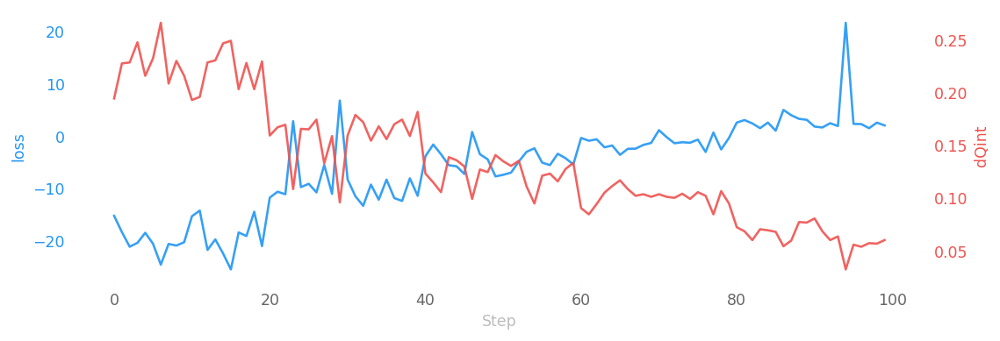

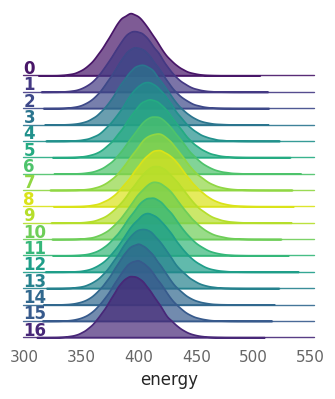

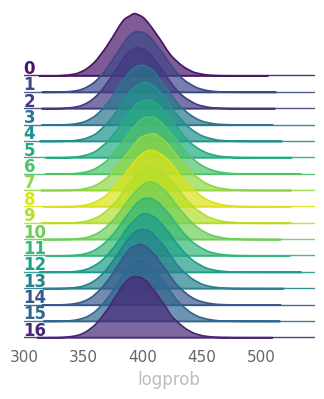

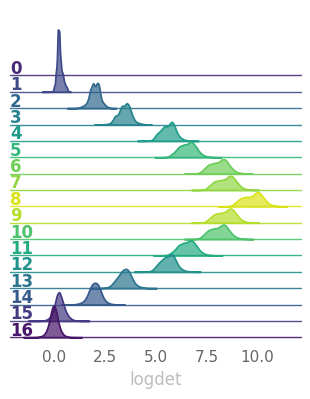

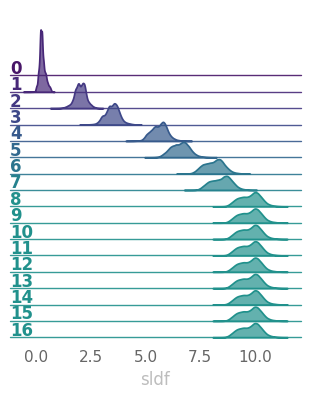

...

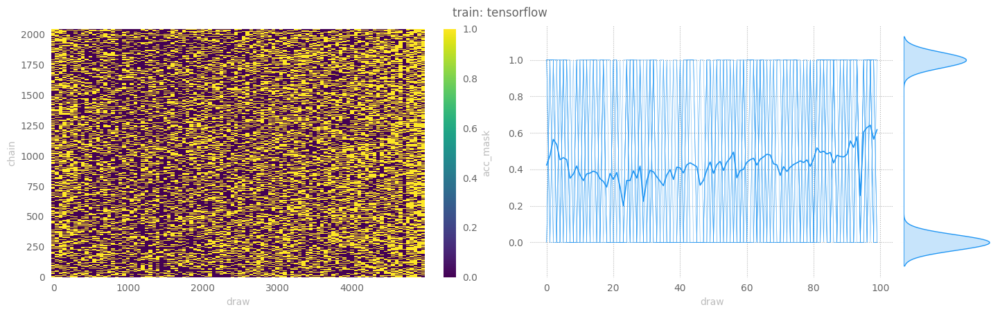

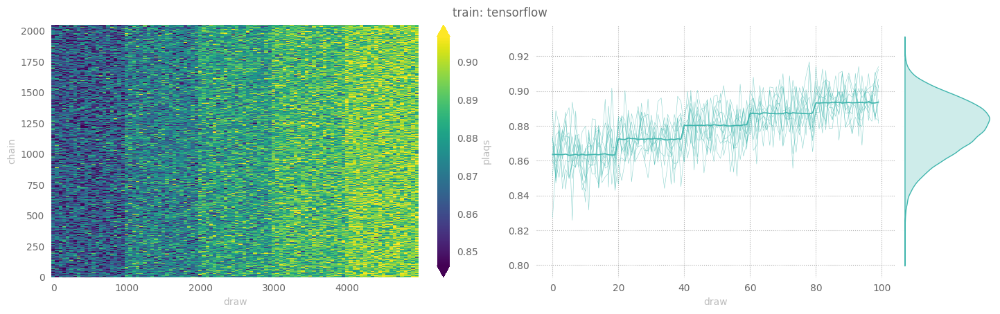

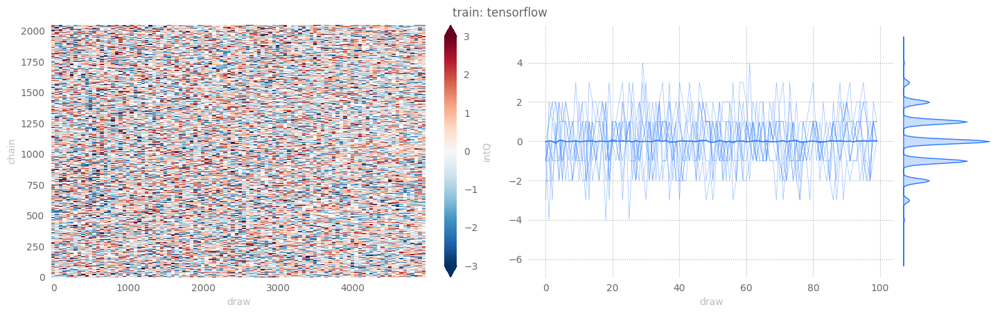

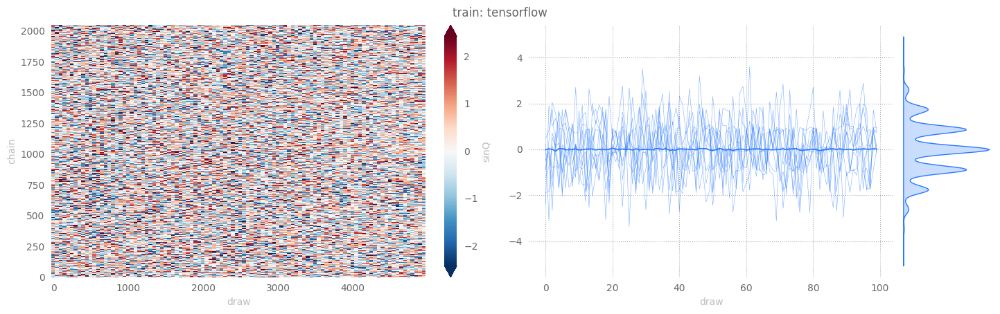

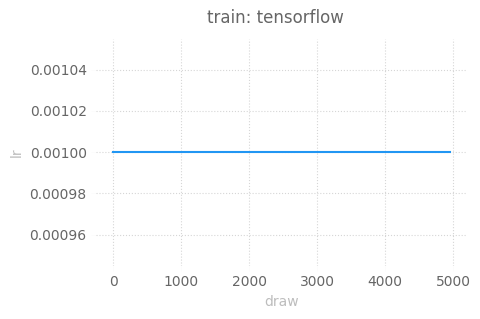

In [9]:
set_plot_style()
outputs['tensorflow']['train'] = tfExpU1.train()

### Evaluate

[07:02:35] WARNING  x.shape (original): (2048, 2, 16, 16)

           WARNING  x[:nchains].shape: (128, 2, 16, 16)

           INFO     eps = None                                                               
                    beta = 5.0                                                               
                    nlog = 10                                                                
                    table = <rich.table.Table object at 0x7ff0bc15beb0>                      
                    nprint = 250                                                             
                    eval_steps = 2000                                                        
                    nleapfrog = None

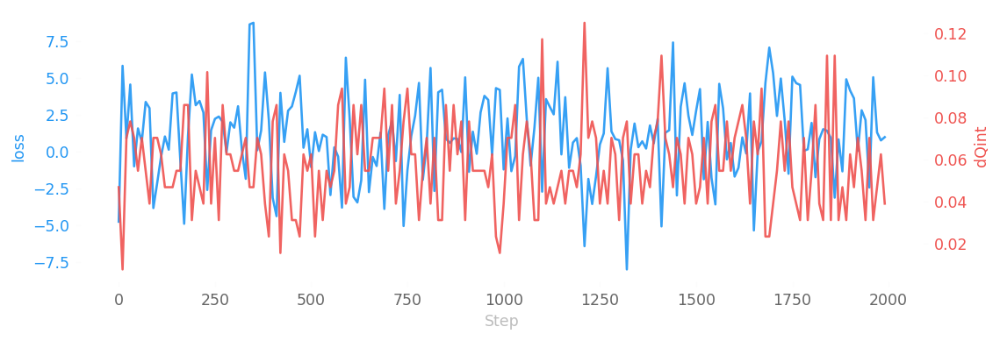

  0%|          | 0/2000 [00:00<?, ?it/s]

[07:02:17] INFO     estep=0   dt=7.4591 beta=5.0000 loss=-4.7694 dQsin=0.1444 dQint=0.0469   
                    energy=403.4174 logprob=399.1784 logdet=4.2390 sldf=6.6017 sldb=-2.3627  
                    sld=4.2390 xeps=0.1761 veps=0.1534 acc=0.7050 sumlogdet=0.0005           
                    acc_mask=0.6797 plaqs=0.8922 intQ=-0.0312 sinQ=-0.0275

[07:02:42] INFO     estep=250 dt=0.0330 beta=5.0000 loss=2.2225 dQsin=0.1304 dQint=0.0703    
                    energy=402.7437 logprob=398.5099 logdet=4.2339 sldf=6.5967 sldb=-2.3628  
                    sld=4.2339 xeps=0.1761 veps=0.1534 acc=0.6001 sumlogdet=0.0006           
                    acc_mask=0.6328 plaqs=0.8950 intQ=0.0391 sinQ=0.0625

[07:02:58] INFO     estep=500 dt=0.0331 beta=5.0000 loss=-1.0608 dQsin=0.1414 dQint=0.0625   
                    energy=400.2929 logprob=396.0580 logdet=4.2350 sldf=6.5998 sldb=-2.3648  
                    sld=4.2350 xeps=0.1761 veps=0.1534 acc=0.6303 sumlogdet=-0.0004          
                    acc_mask=0.6484 plaqs=0.8946 intQ=0.0313 sinQ=0.0189

[07:02:14] INFO     estep=750 dt=0.0331 beta=5.0000 loss=-1.2764 dQsin=0.1699 dQint=0.0938   
                    energy=399.9449 logprob=395.7164 logdet=4.2284 sldf=6.5872 sldb=-2.3587  
                    sld=4.2284 xeps=0.1761 veps=0.1534 acc=0.6226 sumlogdet=-0.0114          
                    acc_mask=0.5938 plaqs=0.8932 intQ=0.1484 sinQ=0.1475

[07:02:31] INFO     estep=1000 dt=0.0333 beta=5.0000 loss=-1.2198 dQsin=0.1244 dQint=0.0391  
                    energy=402.3327 logprob=398.1032 logdet=4.2295 sldf=6.5948 sldb=-2.3653  
                    sld=4.2295 xeps=0.1761 veps=0.1534 acc=0.6393 sumlogdet=-0.0136          
                    acc_mask=0.6172 plaqs=0.8935 intQ=0.0938 sinQ=0.0814

[07:02:47] INFO     estep=1250 dt=0.0331 beta=5.0000 loss=0.4762 dQsin=0.1264 dQint=0.0391   
                    energy=398.9243 logprob=394.6944 logdet=4.2299 sldf=6.5931 sldb=-2.3632  
                    sld=4.2299 xeps=0.1761 veps=0.1534 acc=0.6501 sumlogdet=0.0063           
                    acc_mask=0.7109 plaqs=0.8938 intQ=0.0469 sinQ=0.0311

[07:02:04] INFO     estep=1500 dt=0.0353 beta=5.0000 loss=2.7721 dQsin=0.1235 dQint=0.0391   
                    energy=400.2801 logprob=396.0396 logdet=4.2405 sldf=6.6014 sldb=-2.3608  
                    sld=4.2405 xeps=0.1761 veps=0.1534 acc=0.6700 sumlogdet=0.0096           
                    acc_mask=0.6641 plaqs=0.8945 intQ=-0.1406 sinQ=-0.1391

[07:02:24] INFO     estep=1750 dt=0.0332 beta=5.0000 loss=5.0920 dQsin=0.1294 dQint=0.0469   
                    energy=399.2825 logprob=395.0345 logdet=4.2480 sldf=6.6111 sldb=-2.3631  
                    sld=4.2480 xeps=0.1761 veps=0.1534 acc=0.7116 sumlogdet=0.0091           
                    acc_mask=0.7031 plaqs=0.8938 intQ=-0.0469 sinQ=-0.0437

[07:02:44] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/eval/plots/ridgeplots/svgs/energy_ridgeplot.svg

[07:02:45] INFO     Ridgeplot for energy took 4.855s

[07:02:49] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/eval/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[07:02:50] INFO     Ridgeplot for logprob took 5.104s

[07:02:54] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/eval/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[07:02:55] INFO     Ridgeplot for logdet took 5.096s

[07:02:59] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/eval/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[08:02:00] INFO     Ridgeplot for sldf took 4.919s

[08:02:04] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/eval/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[08:02:05] INFO     Ridgeplot for sldb took 4.318s

[08:02:09] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/eval/plots/ridgeplots/svgs/sld_ridgeplot.svg

[08:02:10] INFO     Ridgeplot for sld took 5.114s

[08:02:22] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorfl
                    ow/eval/data/eval_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

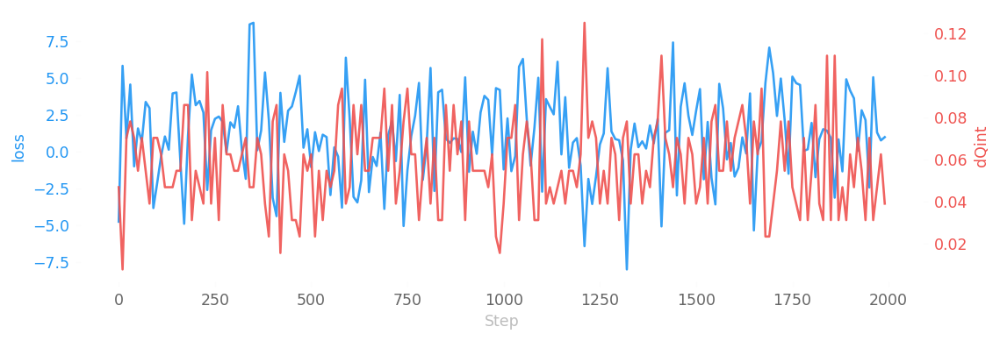

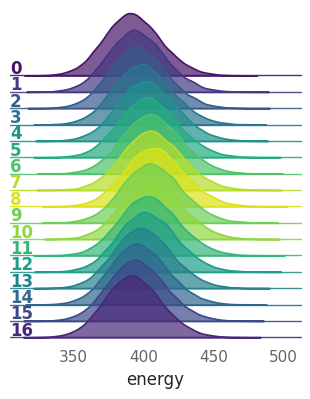

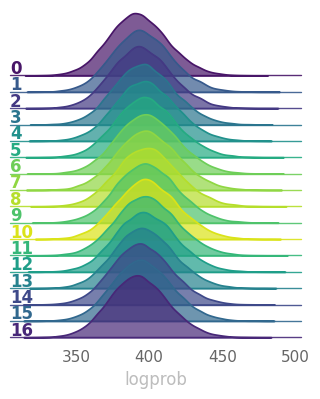

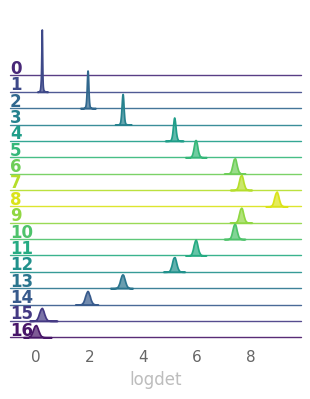

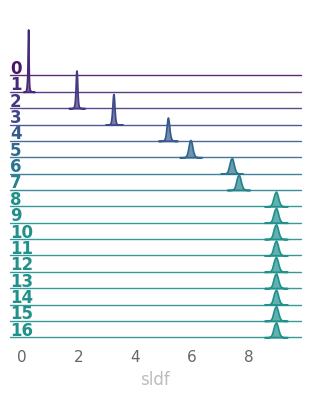

...

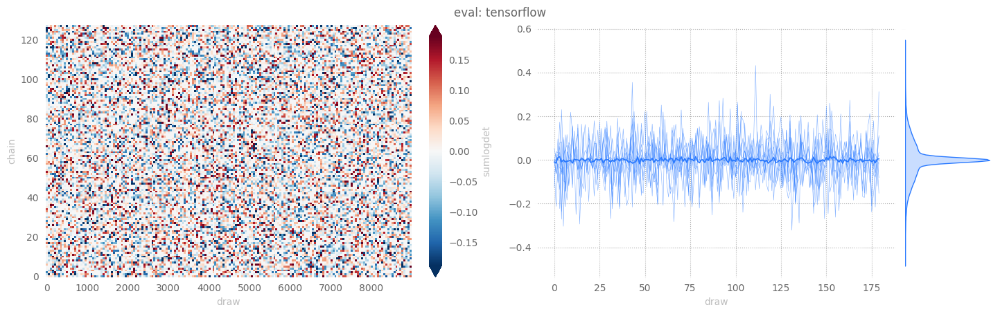

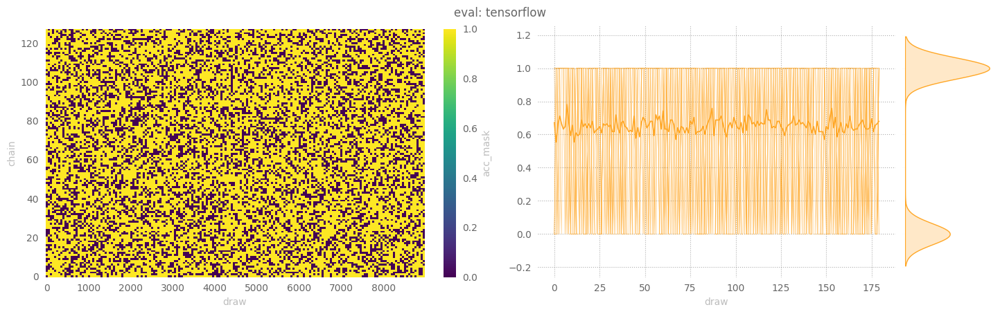

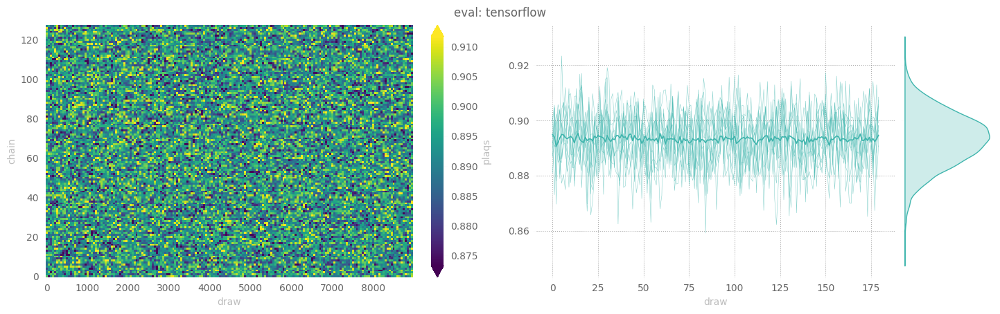

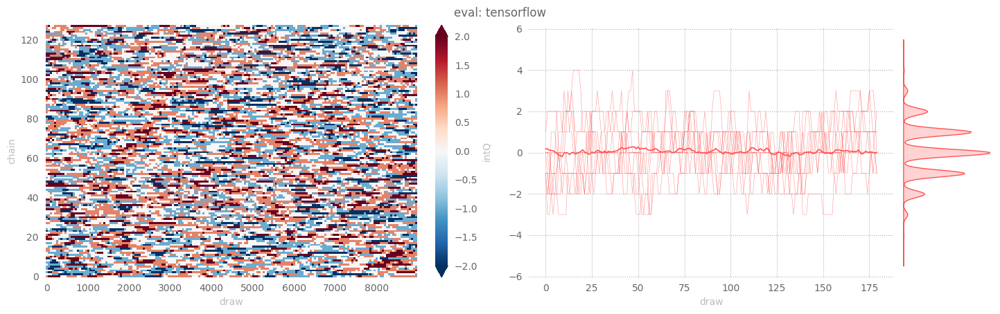

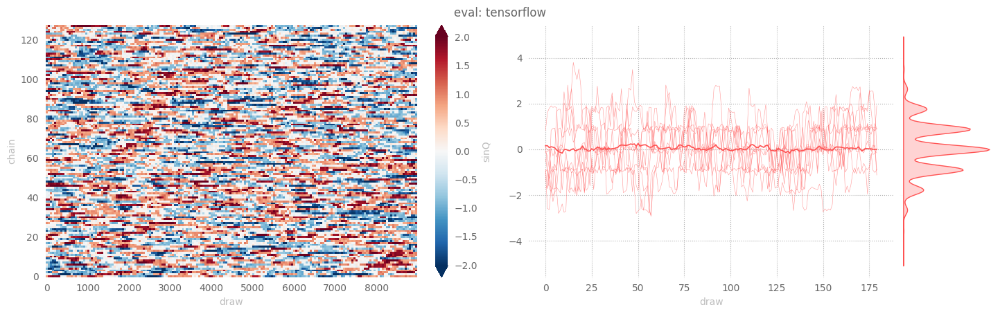

In [10]:
outputs['tensorflow']['eval'] = tfExpU1.evaluate(
    job_type='eval',
    nprint=250,
    nchains=128,
    eval_steps=2000,
)

### HMC

[08:02:31] WARNING  Step size `eps` not specified for HMC! Using default: 0.1250 for generic 
                    HMC

           WARNING  x.shape (original): (2048, 2, 16, 16)

           WARNING  x[:nchains].shape: (128, 2, 16, 16)

           INFO     eps = 0.125                                                              
                    beta = 5.0                                                               
                    nlog = 10                                                                
                    table = <rich.table.Table object at 0x7febd06e5820>                      
                    nprint = 250                                                             
                    eval_steps = 2000                                                        
                    nleapfrog = 16

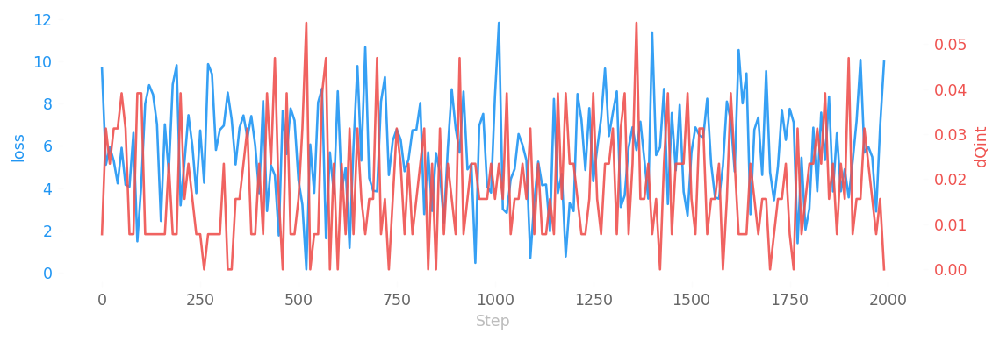

  0%|          | 0/2000 [00:00<?, ?it/s]

[08:02:06] INFO     hstep=0   dt=0.2118 beta=5.0000 loss=9.6527 dQsin=0.0852 dQint=0.0078    
                    energy=393.3057 logprob=393.3057 logdet=0.0000 acc=0.5829                
                    sumlogdet=0.0000 acc_mask=0.6016 plaqs=0.8937 intQ=-0.0859 sinQ=-0.0815

[08:02:38] INFO     hstep=250 dt=0.0969 beta=5.0000 loss=6.7269 dQsin=0.0913 dQint=0.0078    
                    energy=393.8802 logprob=393.8802 logdet=0.0000 acc=0.5963                
                    sumlogdet=0.0000 acc_mask=0.5781 plaqs=0.8926 intQ=-0.0859 sinQ=-0.1067

[08:02:10] INFO     hstep=500 dt=0.0968 beta=5.0000 loss=4.3774 dQsin=0.1092 dQint=0.0156    
                    energy=388.4216 logprob=388.4216 logdet=0.0000 acc=0.5793                
                    sumlogdet=0.0000 acc_mask=0.5703 plaqs=0.8948 intQ=-0.0469 sinQ=-0.0383

[08:02:43] INFO     hstep=750 dt=0.0969 beta=5.0000 loss=6.7763 dQsin=0.1050 dQint=0.0313    
                    energy=388.8663 logprob=388.8663 logdet=0.0000 acc=0.6479                
                    sumlogdet=0.0000 acc_mask=0.6328 plaqs=0.8946 intQ=0.0078 sinQ=-0.0068

[08:02:17] INFO     hstep=1000 dt=0.0965 beta=5.0000 loss=8.3665 dQsin=0.0851 dQint=0.0156   
                    energy=388.8586 logprob=388.8586 logdet=0.0000 acc=0.6097                
                    sumlogdet=0.0000 acc_mask=0.5859 plaqs=0.8951 intQ=-0.1094 sinQ=-0.0944

[08:02:49] INFO     hstep=1250 dt=0.0958 beta=5.0000 loss=4.3279 dQsin=0.1157 dQint=0.0391   
                    energy=394.1874 logprob=394.1874 logdet=0.0000 acc=0.6081                
                    sumlogdet=0.0000 acc_mask=0.5859 plaqs=0.8933 intQ=-0.1406 sinQ=-0.1110

[08:02:21] INFO     hstep=1500 dt=0.0956 beta=5.0000 loss=5.7016 dQsin=0.1008 dQint=0.0156   
                    energy=392.6664 logprob=392.6664 logdet=0.0000 acc=0.6091                
                    sumlogdet=0.0000 acc_mask=0.5391 plaqs=0.8942 intQ=0.0703 sinQ=0.0463

[08:02:53] INFO     hstep=1750 dt=0.0952 beta=5.0000 loss=7.7510 dQsin=0.1052 dQint=0.0078   
                    energy=391.4617 logprob=391.4617 logdet=0.0000 acc=0.6708                
                    sumlogdet=0.0000 acc_mask=0.6641 plaqs=0.8931 intQ=-0.1094 sinQ=-0.1189

[08:02:31] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/hmc/plots/ridgeplots/svgs/energy_ridgeplot.svg

[08:02:32] INFO     Ridgeplot for energy took 6.603s

[08:02:36] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/hmc/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[08:02:37] INFO     Ridgeplot for logprob took 4.984s

[08:02:40] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorflo
                    w/hmc/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[08:02:41] INFO     Ridgeplot for logdet took 3.746s

[08:02:54] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-09-065811/tensorfl
                    ow/hmc/data/hmc_data.h5

[08:02:56] INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

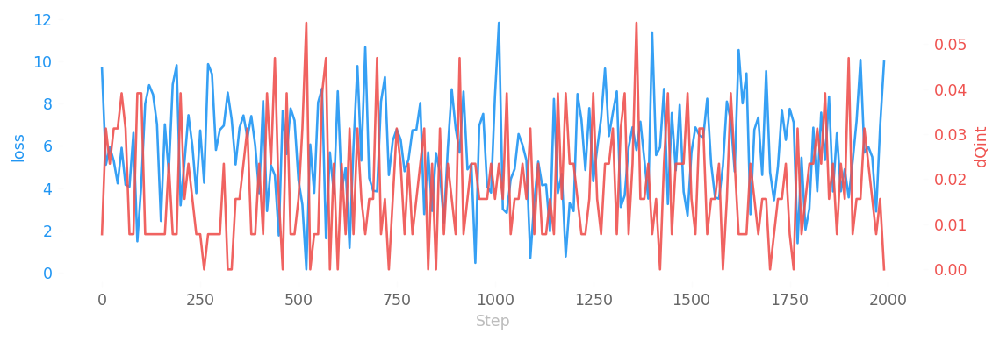

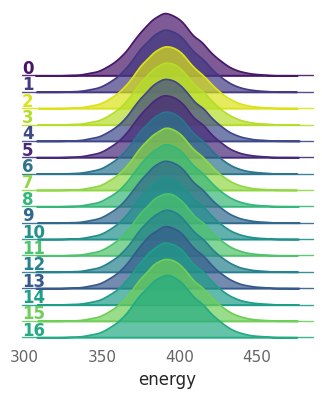

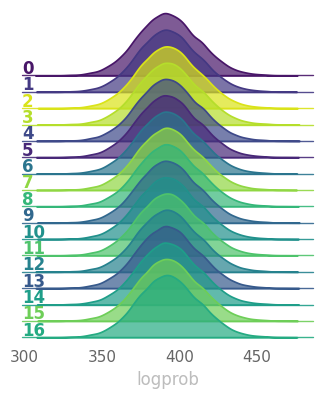

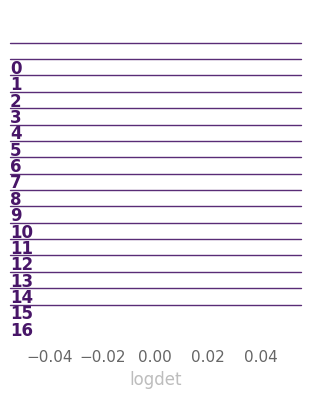

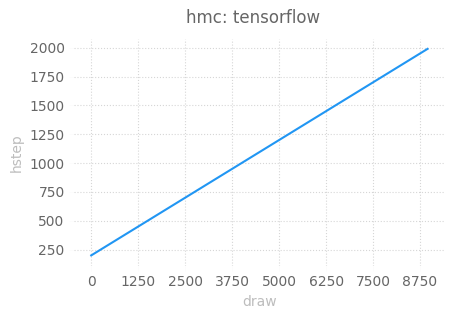

...

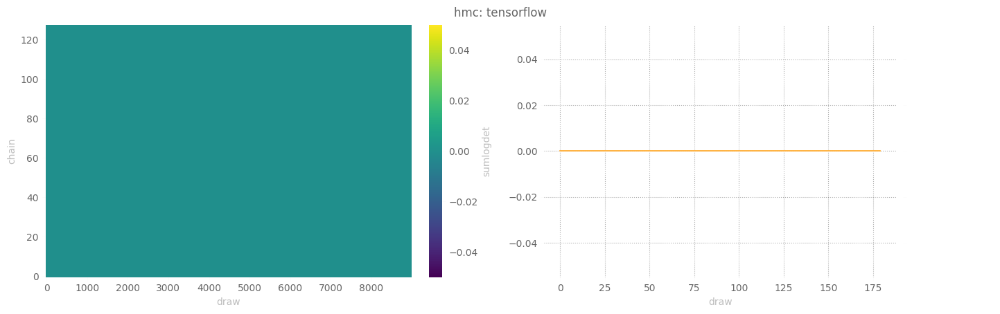

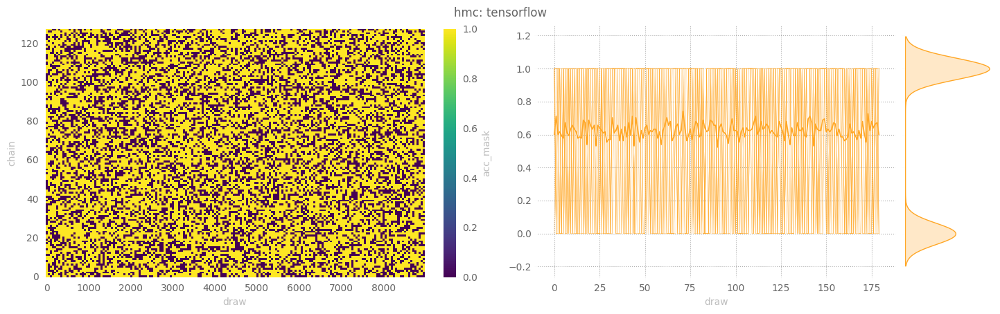

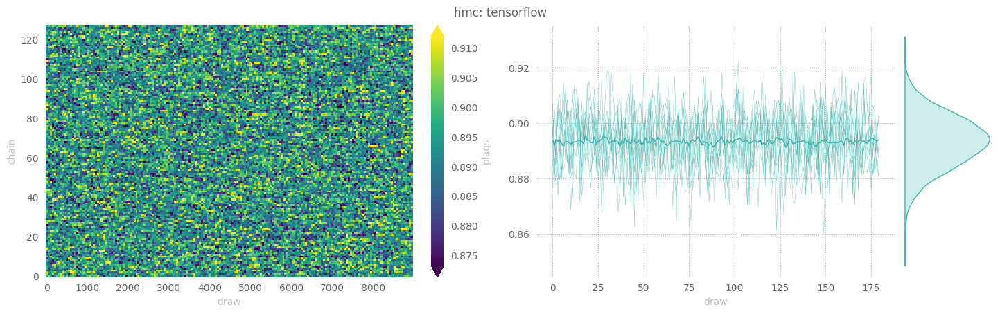

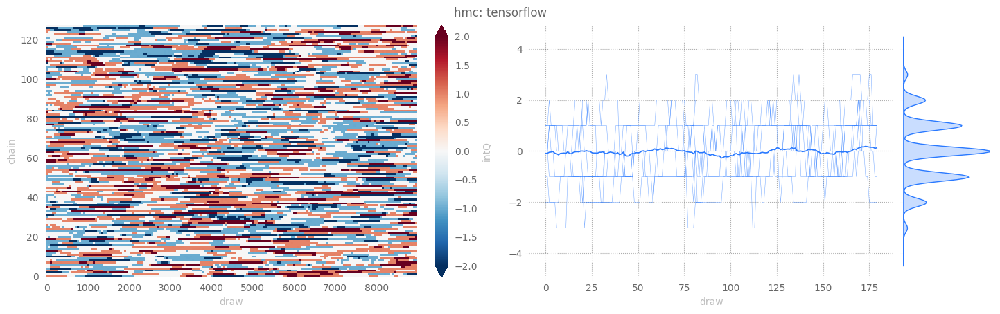

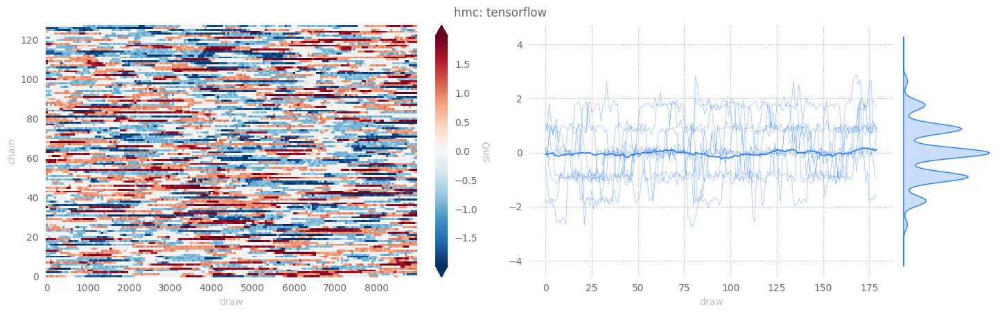

In [11]:
outputs['tensorflow']['hmc'] = tfExpU1.evaluate(
    job_type='hmc',
    nprint=250,
    nchains=128,
    eval_steps=2000,
)

# Model Performance

Our goal is improving the efficiency of our MCMC sampler.

In particular, we are interested in generating **independent** configurations which we can then use to calculate expectation values of physical observables.

For our purposes, we are interested in obtaining lattice configurations from distinct _topological charge sectors_, as characterized by a configurations _topological charge_, $Q$.

HMC is known to suffer from _critical slowing down_, a phenomenon in which our configurations remains stuck in some local topological charge sector and fails to produce distinct configurations.

In particular, it is known that the integrated autocorrelation time of the topological charge $\tau^{Q}$ grows exponentially with decreasing lattice spacing (i.e. continuum limit), making this theory especially problematic.

Because of this, we can assess our models' performance by looking at the _tunneling rate_, i.e. the rate at which our sampler jumps between these different charge sectors.

We can write this quantity as:

$$
\delta Q = |Q^{(i)} - Q^{(i-1)}|
$$

where we look at the difference in the topological charge between sequential configurations.

<div class="alert alert-block alert-info" style="background:rgba(128, 215, 255, 0.1); color: rgb(128, 215, 255); border: 0px solid; border-radius:5px;">
<b>Note:</b> 
The efficiency of our sampler is directly proportional to the tunneling rate, which is inversely proportional to the integrated autocorrelation time $\tau_{\mathrm{int}}^{Q}$, i.e.

&nbsp;

$$
\text{Efficiency } \propto \frac{1}{\tau_{\mathrm{int}}^{Q}} \propto \delta Q
$$

Explicitly, this means that the **more efficient** the model $\longrightarrow$

- the **larger** tunneling rate
- the **smaller** integrated autocorrelation time for $Q$
</div>

In [12]:
import xarray as xr

def get_thermalized_configs(
        x: np.ndarray | xr.DataArray,
        drop: int = 5
) -> np.ndarray | xr.DataArray:
    if isinstance(x, np.ndarray):
        return np.sort(x)[..., :-drop]
    if isinstance(x, xr.DataArray):
        return x.sortby(
            ['chain', 'draw'],
            ascending=False
        )[..., :-drop]
    raise TypeError

# Comparisons

We can measure our models' performance explicitly by looking at the average tunneling rate, $\delta Q_{\mathbb{Z}}$, for our **trained model** and comparing it against generic HMC.

Recall,

$$\delta Q_{\mathbb{Z}} := \big|Q^{(i+1)}_{\mathbb{Z}} - Q^{(i)}_{\mathbb{Z}}\big|$$

where a **higher** value of $\delta Q_{\mathbb{Z}}$ corresponds to **better** tunneling of the topological charge, $Q_{\mathbb{Z}}$.

Note that we can get a concise representation of the data from different parts of our run via:

Note that the data from each of the different parts of our experiment (i.e. `train`, `eval`, and `hmc`) are stored as a dict, e.g.

```python
>>> list(ptExpU1.trainer.histories.keys())
['train', 'eval', 'hmc']
>>> train_history = ptExpU1.trainer.histories['train']
>>> train_dset = train_history.get_dataset()
>>> assert isinstance(train_history, l2hmc.utils.history.BaseHistory)
>>> assert isinstance(train_dset, xarray.Dataset)
```

(see below, for example)

We aggregate the data into the `dsets` dict below, grouped by:

1. **Framework** (`pytorch` / `tensorflow`)
2. **Job type** (`train`, `eval`, `hmc`)

In [13]:
import logging
log = logging.getLogger(__name__)
dsets = {}
fws = ['pt', 'tf']
modes = ['train', 'eval', 'hmc']
for fw in fws:
    dsets[fw] = {}
    for mode in modes:
        hist = None
        if fw == 'pt':
            hist = ptExpU1.trainer.histories.get(mode, None)
        elif fw == 'tf':
            hist = tfExpU1.trainer.histories.get(mode, None)
        if hist is not None:
            log.info(f'Getting dataset for {fw}: {mode}')
            dsets[fw][mode] = hist.get_dataset()

[08:02:02] INFO     Getting dataset for pt: train

           INFO     Getting dataset for pt: eval

           INFO     Getting dataset for pt: hmc

           INFO     Getting dataset for tf: train

           INFO     Getting dataset for tf: eval

[08:02:03] INFO     Getting dataset for tf: hmc

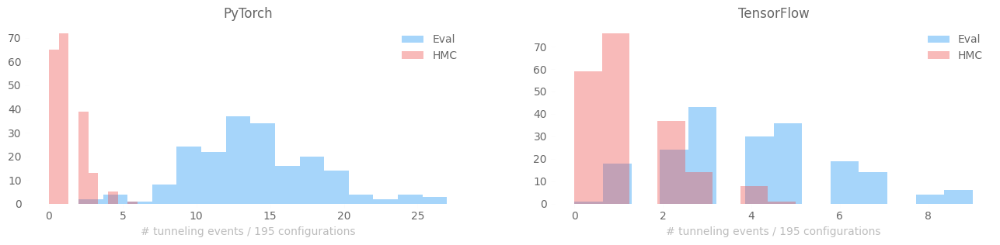

In [14]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['text.usetex'] = False
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import COLORS, set_plot_style

set_plot_style()

fig, ax = plt.subplots(figsize=(16, 3), ncols=2)

# ---------------------------------------------
# ---- DROP FIRST 20% FOR THERMALIZATION ------
# ---------------------------------------------
KEEP = int(0.8 * len(dsets['tf']['eval'].draw))
dqpte = get_thermalized_configs(dsets['pt']['eval']['dQint'].astype('int'))
dqpth = get_thermalized_configs(dsets['pt']['hmc']['dQint'].astype('int'))

dqtfe = get_thermalized_configs(dsets['tf']['eval']['dQint'].astype('int'))
dqtfh = get_thermalized_configs(dsets['tf']['hmc']['dQint'].astype('int'))

_ = sns.distplot(
    dqpte.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[0]
)
_ = sns.distplot(
    dqpth.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[0]
)

_ = ax[0].set_title('PyTorch')
_ = ax[0].set_xlabel(
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[0].legend(loc='best', frameon=False)
plt.legend()

_ = sns.distplot(
    dqtfe.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[1]
)
_ = sns.distplot(
    dqtfh.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[1]
)

_ = ax[1].set_title('TensorFlow')
_ = ax[1].set_xlabel(
    #r"""$\sum_{i=0} \left|\delta Q_{i}\right|$""",
    #fontsize='large',
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[1].legend(loc='best', frameon=False)

## TensorFlow Results

In [15]:
import rich

           INFO     TensorFlow, EVAL                                                         
                     dQint.sum('chain'):                                                     
                     <xarray.DataArray 'dQint' (draw: 90)>                                   
                    array([7, 3, 5, 4, 1, 3, 4, 2, 3, 1, 3, 9, 7, 5, 5, 4, 5, 2, 5, 5, 2, 8, 
                           6, 3, 2, 1, 3, 2, 2, 7, 7, 7, 4, 3, 2, 7, 2, 3, 4, 3, 4, 2, 5, 3, 
                           5, 7, 5, 3, 9, 3, 6, 6, 6, 4, 3, 5, 3, 7, 2, 1, 2, 4, 4, 4, 5, 3, 
                           4, 1, 3, 3, 5, 8, 3, 3, 8, 1, 8, 2, 3, 2, 6, 1, 4, 3, 1, 5, 1, 1, 
                           3, 3])                                                            
                    Coordinates:                                                             
                      * draw     (draw) int64 110 111 112 113 114 115 ... 194 195 196 197 198
                    199

           INFO     dQint.sum(): <xarray.DataArray 'dQint' ()>                               
                    array(354)

           INFO     TensorFlow, HMC                                                          
                     dQint.sum('chain'):                                                     
                     <xarray.DataArray 'dQint' (draw: 90)>                                   
                    array([0, 1, 1, 1, 1, 1, 4, 2, 4, 1, 2, 2, 1, 0, 1, 2, 1, 1, 2, 2, 2, 1, 
                           1, 3, 0, 2, 2, 1, 1, 2, 0, 0, 0, 2, 3, 0, 2, 1, 2, 2, 1, 1, 1, 3, 
                           0, 0, 0, 2, 0, 1, 2, 3, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 3, 1, 
                           0, 4, 1, 2, 2, 1, 1, 2, 3, 1, 2, 0, 0, 1, 2, 1, 1, 0, 2, 0, 1, 0, 
                           1, 0])                                                            
                    Coordinates:                                                             
                      * draw     (draw) int64 110 111 112 113 114 115 ... 194 195 196 197 198
                    199

           INFO     dQint.sum(): <xarray.DataArray 'dQint' ()>                               
                    array(109)

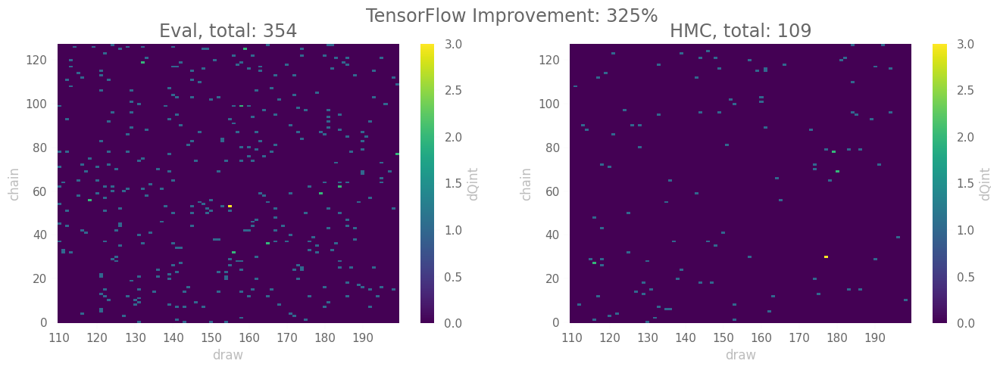

In [16]:
sns.set_context('notebook')
ndraws = len(dsets['tf']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['tf']['eval']['dQint'][:, -90:]
dqh = dsets['tf']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'TensorFlow Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

log.info(f"TensorFlow, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T}")
log.info(f"dQint.sum(): {dqe.astype(int).sum().T}")
log.info(f"TensorFlow, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T}")
log.info(f"dQint.sum(): {dqh.astype(int).sum().T}")

### PyTorch Results

[08:02:04] INFO     PyTorch, EVAL                                                            
                     dQint.sum('chain'):                                                     
                     [ 8 21 13 13  9 20 14 12 14  8 16 20 19 11  4 21 11 15 12 11 18 18 17 15
                      5 27 13 11 25  9 19 15 11 19 13  9 14 14 24 14 10 14 16 15 13 10 13 12 
                     17  8 12 11 12 10 14 19 11  7 17 25 12 16  6 21 14  9 12 19 11  5  9 17 
                     13 17 11 16 12 13 13 20 11  7 10 15 14 14 13 10  8 15]

           INFO     dQint.sum(): 1231

           INFO     PyTorch, HMC                                                             
                     dQint.sum('chain'):                                                     
                     [1 1 0 0 0 0 0 0 2 2 1 3 2 6 2 2 1 2 1 1 3 0 1 4 0 3 1 3 2 1 0 1 0 3 0 3
                    0                                                                        
                     0 1 1 0 1 1 2 0 1 1 1 2 3 1 2 0 0 1 1 2 0 0 2 0 3 2 0 0 3 2 4 0 1 1 1 1 
                    1                                                                        
                     1 0 4 1 0 1 1 1 1 1 2 3 2 0 1 2]

           INFO     dQint.sum(): 115

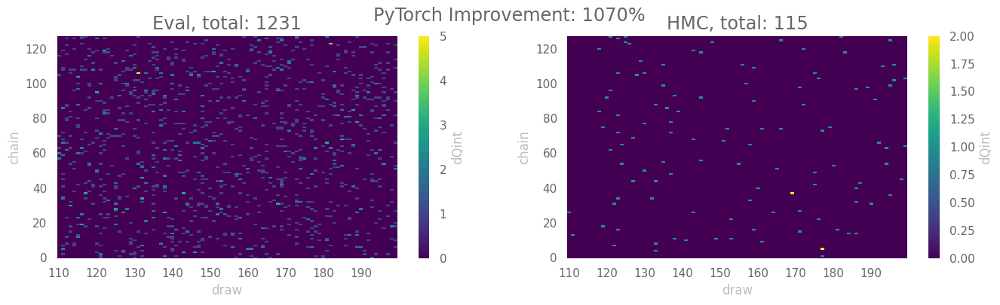

In [17]:
sns.set_context('notebook')
ndraws = len(dsets['pt']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['pt']['eval']['dQint'][:, -90:]
dqh = dsets['pt']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], 0.8 * fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'PyTorch Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

log.info(f"PyTorch, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T.values}")
log.info(f"dQint.sum(): {dqe.astype(int).sum().T.values}")
log.info(f"PyTorch, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T.values}")
log.info(f"dQint.sum(): {dqh.astype(int).sum().T.values}")

## Comparisons

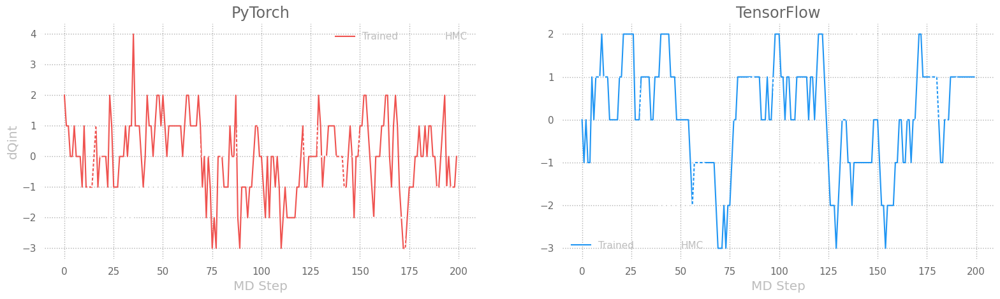

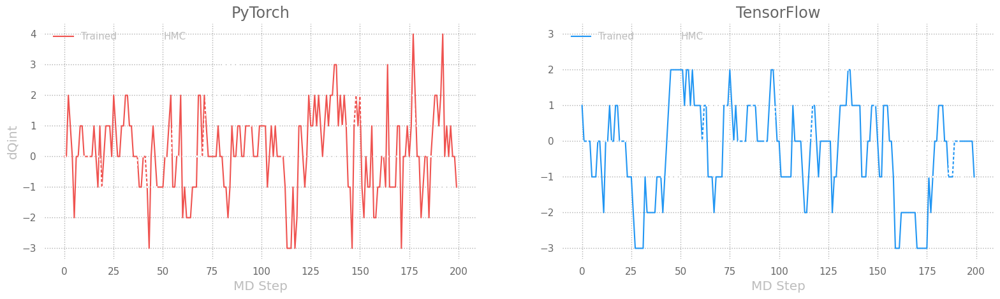

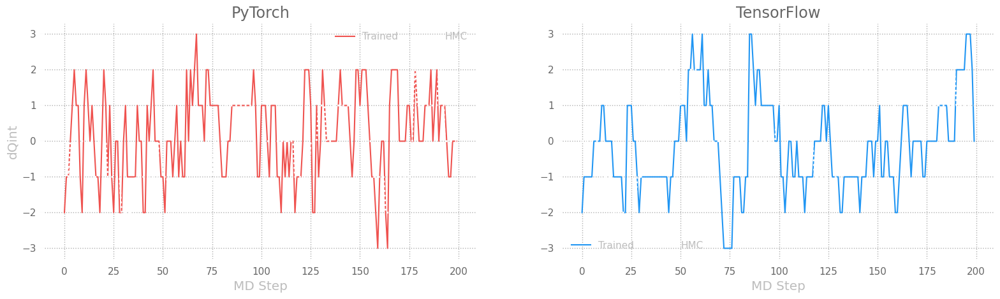

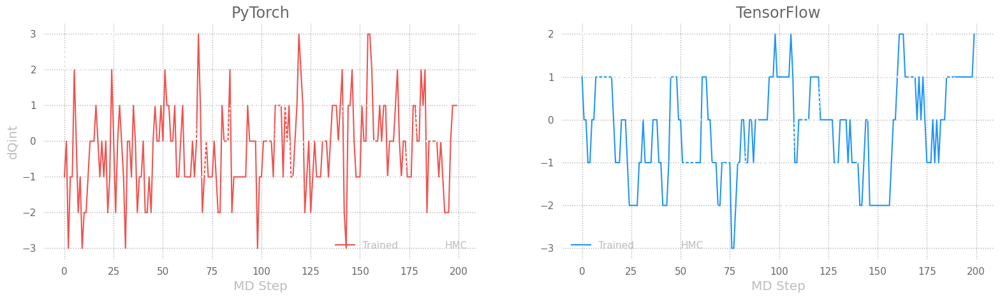

In [18]:
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import set_plot_style, COLORS

import seaborn as sns
set_plot_style()
plt.rcParams['axes.linewidth'] = 2.0
sns.set_context('notebook')
figsize = plt.rcParamsDefault['figure.figsize']
plt.rcParams['figure.dpi'] = plt.rcParamsDefault['figure.dpi']

for idx in range(4):
    fig, (ax, ax1) = plt.subplots(
        ncols=2,
        #nrows=4,
        figsize=(3. * figsize[0], figsize[1]),
    )
    _ = ax.plot(
        dsets['pt']['eval'].intQ[idx],  # .dQint.mean('chain')[100:],
        color=COLORS['red'],
        ls='-',
        label='Trained',
        lw=1.5,
    );

    _ = ax.plot(
        dsets['pt']['hmc'].intQ[idx],  # .dQint.mean('chain')[100:],
        ls=':',
        label='HMC',
        color='#ffffff',
        zorder=5,
        lw=2.0,
    );

    _ = ax1.plot(
        dsets['tf']['eval'].intQ[idx],  # .dQint.mean('chain')[-100:],
        color=COLORS['blue'],
        ls='-',
        label='Trained',
        lw=1.5,

    );
    _ = ax1.plot(
        dsets['tf']['hmc'].intQ[idx],  # .dQint.mean('chain')[-100:],
        color='#ffffff',
        ls=':',
        label='HMC',
        zorder=5,
        lw=2.0,
    );
    _ = ax.set_title('PyTorch', fontsize='x-large')
    _ = ax1.set_title('TensorFlow', fontsize='x-large')
    #_ = ax1.set_ylim(ax.get_ylim())
    _ = ax.grid(True, alpha=0.4)
    _ = ax1.grid(True, alpha=0.4)
    _ = ax.set_xlabel('MD Step', fontsize='large')
    _ = ax1.set_xlabel('MD Step', fontsize='large')
    _ = ax.set_ylabel('dQint', fontsize='large')
    _ = ax.legend(loc='best', framealpha=0.0, ncol=2, labelcolor='#bdbdbd')
    _ = ax1.legend(loc='best', framealpha=0.0, ncol=2, labelcolor='#bdbdbd')